# ANALYSE SCRNA-SEQ DATA FROM NTCU-MOUSE MODEL TRACHEA

In [1]:
# import modules needed for analysis
import scanpy as sc
import anndata as ad
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib as mpl
from matplotlib import rcParams
import scrublet as scr
import scirpy
sc.logging.print_versions()
sc.set_figure_params(facecolor="white", figsize=(8, 8))
sc.settings.verbosity = 3

-----
anndata     0.9.1
scanpy      1.9.1
-----
Levenshtein                 NA
PIL                         9.5.0
adjustText                  NA
airr                        1.3.1
asttokens                   NA
backcall                    0.2.0
cairo                       1.23.0
cffi                        1.15.1
colorama                    0.4.6
comm                        0.1.3
cycler                      0.10.0
cython_runtime              NA
dateutil                    2.8.2
debugpy                     1.6.7
decorator                   5.1.1
defusedxml                  0.7.1
dill                        0.3.4
executing                   1.2.0
google                      NA
h5py                        3.8.0
igraph                      0.10.4
importlib_resources         NA
ipykernel                   6.23.0
ipython_genutils            0.2.0
ipywidgets                  7.6.5
jedi                        0.18.2
joblib                      1.2.0
jupyter_server              2.5.0
kiwisolver  

In [2]:
# determine path to save final result to 
results_file = '/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/NTCU_GEX_Trachea_processed.h5ad'  # the file that will store the analysis results

## READ IN THE DATA AND CHECK AT QC METRICES

In [3]:
adata_1 = sc.read_10x_h5('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_06d662cbe4721a21ee932058d5aa0286/per_sample_outs/cellranger700_multi_06d662cbe4721a21ee932058d5aa0286/count/sample_filtered_feature_bc_matrix.h5')                              # write a cache file for faster subsequent reading
adata_1.var_names_make_unique()
adata_1

# make some metadata
adata_1.obs['sample'] = "MD7176b_d"
adata_1.obs['patientID'] = "MD7176"
adata_1.obs['tissue'] = "Trachea"
adata_1.obs['phenotype'] = "NTCU-treated"
adata_1.obs['age'] = "21 weeks"

reading /lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_06d662cbe4721a21ee932058d5aa0286/per_sample_outs/cellranger700_multi_06d662cbe4721a21ee932058d5aa0286/count/sample_filtered_feature_bc_matrix.h5
 (0:00:05)


/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [4]:
scrub_1 = scr.Scrublet(
        counts_matrix=adata_1.X,
        expected_doublet_rate=0.1,  # Default is 0.1
        random_state=0)

# predict doublets
doublet_scores, predicted_doublets = scrub_1.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)


adata_1.obs['scrublet__predicted_multiplet'] = scrub_1.predicted_doublets_
adata_1.obs['scrublet__multiplet_scores'] = scrub_1.doublet_scores_obs_
adata_1.obs['scrublet__multiplet_zscores'] = scrub_1.z_scores_

# count the number of predicted multiplets
adata_1.obs['scrublet__predicted_multiplet'].value_counts() 

# remove predicted doublets
adata_1 = adata_1[adata_1.obs['scrublet__predicted_multiplet'] == False]

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.69
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.1%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 0.0%
Elapsed time: 12.1 seconds


In [5]:
adata_2 = sc.read_10x_h5('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_2318721347829e44d53a34955b51ca53/per_sample_outs/cellranger700_multi_2318721347829e44d53a34955b51ca53/count/sample_filtered_feature_bc_matrix.h5')                              # write a cache file for faster subsequent reading
adata_2.var_names_make_unique()
adata_2

# make some metadata
adata_2.obs['sample'] = "MD7178b_d"
adata_2.obs['patientID'] = "MD7178"
adata_2.obs['tissue'] = "Trachea"
adata_2.obs['phenotype'] = "NTCU-treated"
adata_2.obs['age'] = "21 weeks"

reading /lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_2318721347829e44d53a34955b51ca53/per_sample_outs/cellranger700_multi_2318721347829e44d53a34955b51ca53/count/sample_filtered_feature_bc_matrix.h5
 (0:00:00)


/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [6]:
scrub_2 = scr.Scrublet(
        counts_matrix=adata_2.X,
        expected_doublet_rate=0.1,  # Default is 0.1
        random_state=0)

# predict doublets
doublet_scores, predicted_doublets = scrub_2.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)


adata_2.obs['scrublet__predicted_multiplet'] = scrub_2.predicted_doublets_
adata_2.obs['scrublet__multiplet_scores'] = scrub_2.doublet_scores_obs_
adata_2.obs['scrublet__multiplet_zscores'] = scrub_2.z_scores_

# count the number of predicted multiplets
adata_2.obs['scrublet__predicted_multiplet'].value_counts() 

# remove predicted doublets
adata_2 = adata_2[adata_2.obs['scrublet__predicted_multiplet'] == False]

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.59
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 0.8%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 10.5%
Elapsed time: 7.3 seconds


In [7]:
adata_3 = sc.read_10x_h5('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_aaef44c812f1e770141b5275f71d60ee/per_sample_outs/cellranger700_multi_aaef44c812f1e770141b5275f71d60ee/count/sample_filtered_feature_bc_matrix.h5')                              # write a cache file for faster subsequent reading
adata_3.var_names_make_unique()
adata_3

# make some metadata
adata_3.obs['sample'] = "MD7179b_d"
adata_3.obs['patientID'] = "MD7179"
adata_3.obs['tissue'] = "Trachea"
adata_3.obs['phenotype'] = "Control"
adata_3.obs['age'] = "21 weeks"

reading /lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_aaef44c812f1e770141b5275f71d60ee/per_sample_outs/cellranger700_multi_aaef44c812f1e770141b5275f71d60ee/count/sample_filtered_feature_bc_matrix.h5
 (0:00:00)


/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [8]:
scrub_3 = scr.Scrublet(
        counts_matrix=adata_3.X,
        expected_doublet_rate=0.1,  # Default is 0.1
        random_state=0)

# predict doublets
doublet_scores, predicted_doublets = scrub_3.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)


adata_3.obs['scrublet__predicted_multiplet'] = scrub_3.predicted_doublets_
adata_3.obs['scrublet__multiplet_scores'] = scrub_3.doublet_scores_obs_
adata_3.obs['scrublet__multiplet_zscores'] = scrub_3.z_scores_

# count the number of predicted multiplets
adata_3.obs['scrublet__predicted_multiplet'].value_counts() 

# remove predicted doublets
adata_3 = adata_3[adata_3.obs['scrublet__predicted_multiplet'] == False]

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.77
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.3%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 5.1%
Elapsed time: 8.5 seconds


In [9]:
adata_4 = sc.read_10x_h5('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_b0f792c3cdffa565115ba16baac3a356/per_sample_outs/cellranger700_multi_b0f792c3cdffa565115ba16baac3a356/count/sample_filtered_feature_bc_matrix.h5')                              # write a cache file for faster subsequent reading
adata_4.var_names_make_unique()
adata_4

# make some metadata
adata_4.obs['sample'] = "MD7177b_d"
adata_4.obs['patientID'] = "MD7177"
adata_4.obs['tissue'] = "Trachea"
adata_4.obs['phenotype'] = "NTCU-treated"
adata_4.obs['age'] = "21 weeks"

reading /lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_b0f792c3cdffa565115ba16baac3a356/per_sample_outs/cellranger700_multi_b0f792c3cdffa565115ba16baac3a356/count/sample_filtered_feature_bc_matrix.h5
 (0:00:00)


/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [10]:
scrub_4 = scr.Scrublet(
        counts_matrix=adata_4.X,
        expected_doublet_rate=0.1,  # Default is 0.1
        random_state=0)

# predict doublets
doublet_scores, predicted_doublets = scrub_4.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)


adata_4.obs['scrublet__predicted_multiplet'] = scrub_4.predicted_doublets_
adata_4.obs['scrublet__multiplet_scores'] = scrub_4.doublet_scores_obs_
adata_4.obs['scrublet__multiplet_zscores'] = scrub_4.z_scores_

# count the number of predicted multiplets
adata_4.obs['scrublet__predicted_multiplet'].value_counts() 

# remove predicted doublets
adata_4 = adata_4[adata_4.obs['scrublet__predicted_multiplet'] == False]

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.71
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.8%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 2.0%
Elapsed time: 7.1 seconds


In [11]:
adata_5 = sc.read_10x_h5('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_bdda4051f744f8b1a635646f6a312cdd/per_sample_outs/cellranger700_multi_bdda4051f744f8b1a635646f6a312cdd/count/sample_filtered_feature_bc_matrix.h5')                              # write a cache file for faster subsequent reading
adata_5.var_names_make_unique()
adata_5

# make some metadata
adata_5.obs['sample'] = "MD7216a_c"
adata_5.obs['patientID'] = "MD7216"
adata_5.obs['tissue'] = "Trachea"
adata_5.obs['phenotype'] = "NTCU-treated"
adata_5.obs['age'] = "30 weeks"

reading /lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_bdda4051f744f8b1a635646f6a312cdd/per_sample_outs/cellranger700_multi_bdda4051f744f8b1a635646f6a312cdd/count/sample_filtered_feature_bc_matrix.h5
 (0:00:00)


/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [12]:
scrub_5 = scr.Scrublet(
        counts_matrix=adata_5.X,
        expected_doublet_rate=0.1,  # Default is 0.1
        random_state=0)

# predict doublets
doublet_scores, predicted_doublets = scrub_5.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)


adata_5.obs['scrublet__predicted_multiplet'] = scrub_5.predicted_doublets_
adata_5.obs['scrublet__multiplet_scores'] = scrub_5.doublet_scores_obs_
adata_5.obs['scrublet__multiplet_zscores'] = scrub_5.z_scores_

# count the number of predicted multiplets
adata_5.obs['scrublet__predicted_multiplet'].value_counts() 

# remove predicted doublets
adata_5 = adata_5[adata_5.obs['scrublet__predicted_multiplet'] == False]

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.32
Detected doublet rate = 4.0%
Estimated detectable doublet fraction = 10.1%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 40.0%
Elapsed time: 0.2 seconds


In [13]:
adata_6 = sc.read_10x_h5('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_792c956a7489acafc5ba3fdf6b0c702b/per_sample_outs/cellranger700_multi_792c956a7489acafc5ba3fdf6b0c702b/count/sample_filtered_feature_bc_matrix.h5')                              # write a cache file for faster subsequent reading
adata_6.var_names_make_unique()
adata_6

# make some metadata
adata_6.obs['sample'] = "MD7217a_c"
adata_6.obs['patientID'] = "MD7217"
adata_6.obs['tissue'] = "Trachea"
adata_6.obs['phenotype'] = "NTCU-treated"
adata_6.obs['age'] = "30 weeks"

reading /lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_792c956a7489acafc5ba3fdf6b0c702b/per_sample_outs/cellranger700_multi_792c956a7489acafc5ba3fdf6b0c702b/count/sample_filtered_feature_bc_matrix.h5
 (0:00:00)


/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [14]:
scrub_6 = scr.Scrublet(
        counts_matrix=adata_6.X,
        expected_doublet_rate=0.1,  # Default is 0.1
        random_state=0)

# predict doublets
doublet_scores, predicted_doublets = scrub_6.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)


adata_6.obs['scrublet__predicted_multiplet'] = scrub_6.predicted_doublets_
adata_6.obs['scrublet__multiplet_scores'] = scrub_6.doublet_scores_obs_
adata_6.obs['scrublet__multiplet_zscores'] = scrub_6.z_scores_

# count the number of predicted multiplets
adata_6.obs['scrublet__predicted_multiplet'].value_counts() 

# remove predicted doublets
adata_6 = adata_6[adata_6.obs['scrublet__predicted_multiplet'] == False]

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.38
Detected doublet rate = 0.6%
Estimated detectable doublet fraction = 8.5%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 6.7%
Elapsed time: 0.3 seconds


In [15]:
adata_7 = sc.read_10x_h5('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_0142305efb8afa1472398ac0d51aedf4/per_sample_outs/cellranger700_multi_0142305efb8afa1472398ac0d51aedf4/count/sample_filtered_feature_bc_matrix.h5')                              # write a cache file for faster subsequent reading
adata_7.var_names_make_unique()
adata_7

# make some metadata
adata_7.obs['sample'] = "MD7218a_c"
adata_7.obs['patientID'] = "MD7218"
adata_7.obs['tissue'] = "Trachea"
adata_7.obs['phenotype'] = "NTCU-treated"
adata_7.obs['age'] = "30 weeks"

reading /lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_0142305efb8afa1472398ac0d51aedf4/per_sample_outs/cellranger700_multi_0142305efb8afa1472398ac0d51aedf4/count/sample_filtered_feature_bc_matrix.h5
 (0:00:00)


/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [16]:
scrub_7 = scr.Scrublet(
        counts_matrix=adata_7.X,
        expected_doublet_rate=0.1,  # Default is 0.1
        random_state=0)

# predict doublets
doublet_scores, predicted_doublets = scrub_7.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)


adata_7.obs['scrublet__predicted_multiplet'] = scrub_7.predicted_doublets_
adata_7.obs['scrublet__multiplet_scores'] = scrub_7.doublet_scores_obs_
adata_7.obs['scrublet__multiplet_zscores'] = scrub_7.z_scores_

# count the number of predicted multiplets
adata_7.obs['scrublet__predicted_multiplet'].value_counts() 

# remove predicted doublets
adata_7 = adata_7[adata_7.obs['scrublet__predicted_multiplet'] == False]

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.39
Detected doublet rate = 0.9%
Estimated detectable doublet fraction = 5.2%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 17.1%
Elapsed time: 0.3 seconds


In [17]:
adata_8 = sc.read_10x_h5('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_95fd2b2f029bc5370230f05e86779ae6/per_sample_outs/cellranger700_multi_95fd2b2f029bc5370230f05e86779ae6/count/sample_filtered_feature_bc_matrix.h5')                              # write a cache file for faster subsequent reading
adata_8.var_names_make_unique()
adata_8

# make some metadata
adata_8.obs['sample'] = "MD7219b_c"
adata_8.obs['patientID'] = "MD7219"
adata_8.obs['tissue'] = "Trachea"
adata_8.obs['phenotype'] = "Control"
adata_8.obs['age'] = "21 weeks"

reading /lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_95fd2b2f029bc5370230f05e86779ae6/per_sample_outs/cellranger700_multi_95fd2b2f029bc5370230f05e86779ae6/count/sample_filtered_feature_bc_matrix.h5
 (0:00:00)


/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [18]:
scrub_8 = scr.Scrublet(
        counts_matrix=adata_8.X,
        expected_doublet_rate=0.1,  # Default is 0.1
        random_state=0)

# predict doublets
doublet_scores, predicted_doublets = scrub_8.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)


adata_8.obs['scrublet__predicted_multiplet'] = scrub_8.predicted_doublets_
adata_8.obs['scrublet__multiplet_scores'] = scrub_8.doublet_scores_obs_
adata_8.obs['scrublet__multiplet_zscores'] = scrub_8.z_scores_

# count the number of predicted multiplets
adata_8.obs['scrublet__predicted_multiplet'].value_counts() 

# remove predicted doublets
adata_8 = adata_8[adata_8.obs['scrublet__predicted_multiplet'] == False]

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.38
Detected doublet rate = 1.4%
Estimated detectable doublet fraction = 8.5%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 16.9%
Elapsed time: 0.3 seconds


In [19]:
adata_9 = sc.read_10x_h5('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_0bed10957dd19cc33e73b71da1e438ca/per_sample_outs/cellranger700_multi_0bed10957dd19cc33e73b71da1e438ca/count/sample_filtered_feature_bc_matrix.h5')                              # write a cache file for faster subsequent reading
adata_9.var_names_make_unique()
adata_9

# make some metadata
adata_9.obs['sample'] = "MD7220b_c"
adata_9.obs['patientID'] = "MD7220"
adata_9.obs['tissue'] = "Trachea"
adata_9.obs['phenotype'] = "Control"
adata_9.obs['age'] = "30 weeks"

reading /lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_0bed10957dd19cc33e73b71da1e438ca/per_sample_outs/cellranger700_multi_0bed10957dd19cc33e73b71da1e438ca/count/sample_filtered_feature_bc_matrix.h5
 (0:00:00)


/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [20]:
scrub_9 = scr.Scrublet(
        counts_matrix=adata_9.X,
        expected_doublet_rate=0.1,  # Default is 0.1
        random_state=0)

# predict doublets
doublet_scores, predicted_doublets = scrub_9.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)


adata_9.obs['scrublet__predicted_multiplet'] = scrub_9.predicted_doublets_
adata_9.obs['scrublet__multiplet_scores'] = scrub_9.doublet_scores_obs_
adata_9.obs['scrublet__multiplet_zscores'] = scrub_9.z_scores_

# count the number of predicted multiplets
adata_9.obs['scrublet__predicted_multiplet'].value_counts() 

# remove predicted doublets
adata_9 = adata_9[adata_9.obs['scrublet__predicted_multiplet'] == False]

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.24
Detected doublet rate = 8.9%
Estimated detectable doublet fraction = 23.2%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 38.6%
Elapsed time: 0.2 seconds


In [21]:
adata_10 = sc.read_10x_h5('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_7c11411d3986b073c31f41640babf988/per_sample_outs/cellranger700_multi_7c11411d3986b073c31f41640babf988/count/sample_filtered_feature_bc_matrix.h5')                              # write a cache file for faster subsequent reading
adata_10.var_names_make_unique()
adata_10

# make some metadata
adata_10.obs['sample'] = "MD7221b_c"
adata_10.obs['patientID'] = "MD7221"
adata_10.obs['tissue'] = "Trachea"
adata_10.obs['phenotype'] = "Control"
adata_10.obs['age'] = "30 weeks"

reading /lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_7c11411d3986b073c31f41640babf988/per_sample_outs/cellranger700_multi_7c11411d3986b073c31f41640babf988/count/sample_filtered_feature_bc_matrix.h5
 (0:00:00)


/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [22]:
scrub_10 = scr.Scrublet(
        counts_matrix=adata_10.X,
        expected_doublet_rate=0.1,  # Default is 0.1
        random_state=0)

# predict doublets
doublet_scores, predicted_doublets = scrub_10.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)


adata_10.obs['scrublet__predicted_multiplet'] = scrub_10.predicted_doublets_
adata_10.obs['scrublet__multiplet_scores'] = scrub_10.doublet_scores_obs_
adata_10.obs['scrublet__multiplet_zscores'] = scrub_10.z_scores_

# count the number of predicted multiplets
adata_10.obs['scrublet__predicted_multiplet'].value_counts() 

# remove predicted doublets
adata_10 = adata_10[adata_10.obs['scrublet__predicted_multiplet'] == False]

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.32
Detected doublet rate = 1.6%
Estimated detectable doublet fraction = 5.6%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 28.6%
Elapsed time: 0.2 seconds


In [23]:
adata_11 = sc.read_10x_h5('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_81386faa269a8a1b112a54dbe404e64a/per_sample_outs/cellranger700_multi_81386faa269a8a1b112a54dbe404e64a/count/sample_filtered_feature_bc_matrix.h5')                              # write a cache file for faster subsequent reading
adata_11.var_names_make_unique()
adata_11

# make some metadata
adata_11.obs['sample'] = "MR7351b_c"
adata_11.obs['patientID'] = "MR7351"
adata_11.obs['tissue'] = "Trachea"
adata_11.obs['phenotype'] = "Control"
adata_11.obs['age'] = "30 weeks"

reading /lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_81386faa269a8a1b112a54dbe404e64a/per_sample_outs/cellranger700_multi_81386faa269a8a1b112a54dbe404e64a/count/sample_filtered_feature_bc_matrix.h5
 (0:00:00)


/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [24]:
scrub_11= scr.Scrublet(
        counts_matrix=adata_11.X,
        expected_doublet_rate=0.1,  # Default is 0.1
        random_state=0)

# predict doublets
doublet_scores, predicted_doublets = scrub_11.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)


adata_11.obs['scrublet__predicted_multiplet'] = scrub_11.predicted_doublets_
adata_11.obs['scrublet__multiplet_scores'] = scrub_11.doublet_scores_obs_
adata_11.obs['scrublet__multiplet_zscores'] = scrub_11.z_scores_

# count the number of predicted multiplets
adata_11.obs['scrublet__predicted_multiplet'].value_counts() 

# remove predicted doublets
adata_11 = adata_11[adata_11.obs['scrublet__predicted_multiplet'] == False]

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.64
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.4%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 7.8%
Elapsed time: 10.2 seconds


In [25]:
adata_12 = sc.read_10x_h5('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_a79067c4045f25e960c315ccd7aa78e0/per_sample_outs/cellranger700_multi_a79067c4045f25e960c315ccd7aa78e0/count/sample_filtered_feature_bc_matrix.h5')                              # write a cache file for faster subsequent reading
adata_12.var_names_make_unique()
adata_12

# make some metadata
adata_12.obs['sample'] = "MR7350b_c"
adata_12.obs['patientID'] = "MR7350"
adata_12.obs['tissue'] = "Trachea"
adata_12.obs['phenotype'] = "Control"
adata_12.obs['age'] = "30 weeks"

reading /lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_a79067c4045f25e960c315ccd7aa78e0/per_sample_outs/cellranger700_multi_a79067c4045f25e960c315ccd7aa78e0/count/sample_filtered_feature_bc_matrix.h5
 (0:00:00)


/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [26]:
scrub_12= scr.Scrublet(
        counts_matrix=adata_12.X,
        expected_doublet_rate=0.1,  # Default is 0.1
        random_state=0)

# predict doublets
doublet_scores, predicted_doublets = scrub_12.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)


adata_12.obs['scrublet__predicted_multiplet'] = scrub_12.predicted_doublets_
adata_12.obs['scrublet__multiplet_scores'] = scrub_12.doublet_scores_obs_
adata_12.obs['scrublet__multiplet_zscores'] = scrub_12.z_scores_

# count the number of predicted multiplets
adata_12.obs['scrublet__predicted_multiplet'].value_counts() 

# remove predicted doublets
adata_12 = adata_12[adata_12.obs['scrublet__predicted_multiplet'] == False]

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.76
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.4%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 10.3%
Elapsed time: 28.3 seconds


In [27]:
adata_13 = sc.read_10x_h5('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_c3146fceff922e5fce6d061c98636f09/per_sample_outs/cellranger700_multi_c3146fceff922e5fce6d061c98636f09/count/sample_filtered_feature_bc_matrix.h5')                              # write a cache file for faster subsequent reading
adata_13.var_names_make_unique()
adata_13

# make some metadata
adata_13.obs['sample'] = "MR7352b_c"
adata_13.obs['patientID'] = "MR7352"
adata_13.obs['tissue'] = "Trachea"
adata_13.obs['phenotype'] = "Control"
adata_13.obs['age'] = "21 weeks"

reading /lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_c3146fceff922e5fce6d061c98636f09/per_sample_outs/cellranger700_multi_c3146fceff922e5fce6d061c98636f09/count/sample_filtered_feature_bc_matrix.h5
 (0:00:01)


/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [28]:
scrub_13 = scr.Scrublet(
        counts_matrix=adata_13.X,
        expected_doublet_rate=0.1,  # Default is 0.1
        random_state=0)

# predict doublets
doublet_scores, predicted_doublets = scrub_13.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)


adata_13.obs['scrublet__predicted_multiplet'] = scrub_13.predicted_doublets_
adata_13.obs['scrublet__multiplet_scores'] = scrub_13.doublet_scores_obs_
adata_13.obs['scrublet__multiplet_zscores'] = scrub_13.z_scores_

# count the number of predicted multiplets
adata_13.obs['scrublet__predicted_multiplet'].value_counts() 

# remove predicted doublets
adata_13 = adata_13[adata_13.obs['scrublet__predicted_multiplet'] == False]

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.33
Detected doublet rate = 3.6%
Estimated detectable doublet fraction = 23.0%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 15.8%
Elapsed time: 39.3 seconds


In [29]:
adata_14 = sc.read_10x_h5('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_f7fac9965e5ed4cc6575fb3415c741d9/per_sample_outs/cellranger700_multi_f7fac9965e5ed4cc6575fb3415c741d9/count/sample_filtered_feature_bc_matrix.h5')                              # write a cache file for faster subsequent reading
adata_14.var_names_make_unique()
adata_14

# make some metadata
adata_14.obs['sample'] = "MR7353b_c"
adata_14.obs['patientID'] = "MR7353"
adata_14.obs['tissue'] = "Trachea"
adata_14.obs['phenotype'] = "NTCU-treated"
adata_14.obs['age'] = "30 weeks"

reading /lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/cellranger700_multi_f7fac9965e5ed4cc6575fb3415c741d9/per_sample_outs/cellranger700_multi_f7fac9965e5ed4cc6575fb3415c741d9/count/sample_filtered_feature_bc_matrix.h5
 (0:00:00)


/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [30]:
scrub_14 = scr.Scrublet(
        counts_matrix=adata_14.X,
        expected_doublet_rate=0.1,  # Default is 0.1
        random_state=0)

# predict doublets
doublet_scores, predicted_doublets = scrub_14.scrub_doublets(min_counts=2, 
                                                          min_cells=3, 
                                                          min_gene_variability_pctl=85, 
                                                          n_prin_comps=30)


adata_14.obs['scrublet__predicted_multiplet'] = scrub_14.predicted_doublets_
adata_14.obs['scrublet__multiplet_scores'] = scrub_14.doublet_scores_obs_
adata_14.obs['scrublet__multiplet_zscores'] = scrub_14.z_scores_

# count the number of predicted multiplets
adata_14.obs['scrublet__predicted_multiplet'].value_counts() 

# remove predicted doublets
adata_14 = adata_14[adata_14.obs['scrublet__predicted_multiplet'] == False]

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.67
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.0%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 0.0%
Elapsed time: 32.6 seconds


In [31]:
# Merge all individual samples together
adata = adata_1.concatenate([adata_2,adata_3, adata_4, adata_5, adata_6, adata_7, adata_8, adata_9, adata_10, adata_11, adata_12, adata_13, adata_14], join="outer")
adata.obs

/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/anndata/_core/anndata.py:1755: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


,sample,patientID,tissue,phenotype,age,scrublet__predicted_multiplet,scrublet__multiplet_scores,scrublet__multiplet_zscores,batch
AAACCTGAGACAGGCT-1-0,MD7176b_d,MD7176,Trachea,NTCU-treated,21 weeks,False,0.027316,-87.598982,0
AAACCTGAGCTACCTA-1-0,MD7176b_d,MD7176,Trachea,NTCU-treated,21 weeks,False,0.057971,-41.537284,0
AAACCTGAGTAGATGT-1-0,MD7176b_d,MD7176,Trachea,NTCU-treated,21 weeks,False,0.101996,-22.512209,0
AAACCTGCAAGACACG-1-0,MD7176b_d,MD7176,Trachea,NTCU-treated,21 weeks,False,0.049107,-49.267140,0
AAACCTGCAAGGTTTC-1-0,MD7176b_d,MD7176,Trachea,NTCU-treated,21 weeks,False,0.184564,-10.956832,0
...,...,...,...,...,...,...,...,...,...
TTTGTCATCACATAGC-1-13,MR7353b_c,MR7353,Trachea,NTCU-treated,30 weeks,False,0.051471,-47.207327,13
TTTGTCATCAGTCCCT-1-13,MR7353b_c,MR7353,Trachea,NTCU-treated,30 weeks,False,0.067227,-35.725372,13
TTTGTCATCCGAGCCA-1-13,MR7353b_c,MR7353,Trachea,NTCU-treated,30 weeks,False,0.101604,-22.736989,13
TTTGTCATCCTAGGGC-1-13,MR7353b_c,MR7353,Trachea,NTCU-treated,30 weeks,False,0.086221,-27.305090,13


In [32]:
adata

AnnData object with n_obs × n_vars = 70342 × 32285
    obs: 'sample', 'patientID', 'tissue', 'phenotype', 'age', 'scrublet__predicted_multiplet', 'scrublet__multiplet_scores', 'scrublet__multiplet_zscores', 'batch'
    var: 'gene_ids', 'feature_types', 'genome'

## PERFORM INITIAL QC FILTERING

In [ ]:
# preprocessing
sc.pl.highest_expr_genes(adata, n_top=20)

In [34]:
# basic filtering
sc.pp.filter_cells(adata, min_genes=200)
sc.pp.filter_genes(adata, min_cells=3)

filtered out 4484 cells that have less than 200 genes expressed
filtered out 7227 genes that are detected in less than 3 cells


In [35]:
# calculate some quality metrics as for instance mitochondrial percentage
adata.var['mt'] = adata.var_names.str.startswith('mt-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, inplace=True)

# and for ribosomal genes
adata.var['ribo'] = adata.var_names.str.startswith(('Rps','Rpl'))  # annotate the group of ribosomal genes as 'ribo'
sc.pp.calculate_qc_metrics(adata, qc_vars=['ribo'], percent_top=None, inplace=True)

In [ ]:
# visualize some QC metrics
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_ribo'], jitter=0.4, multi_panel=True)

In [ ]:
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [38]:
# do the actual filtering by slicing the object
adata = adata[1000 < adata.obs.n_genes_by_counts, :]
adata = adata[adata.obs.n_genes_by_counts < 6000, :]
adata = adata[500 < adata.obs.total_counts, :]
adata = adata[adata.obs.total_counts < 35000, :]
adata = adata[adata.obs.pct_counts_mt < 10, :]

In [39]:
# check the mean number of genes and counts
mean_counts = adata.obs['total_counts'].mean()
mean_genes = adata.obs['n_genes'].mean()
mean_mt = adata.obs['pct_counts_mt'].mean()
mean_ribo = adata.obs['pct_counts_ribo'].mean()
print(mean_counts)
print(mean_mt)
print(mean_ribo)
print(mean_genes)

10239.114
3.2365847
14.561736
3005.990468473463


In [40]:
min_counts = adata.obs['total_counts'].min()
max_counts = adata.obs['total_counts'].max()
print(min_counts)
print(max_counts)

1373.0
34963.0


In [41]:
min_genes = adata.obs['n_genes'].min()
max_genes = adata.obs['n_genes'].max()
print(min_genes)
print(max_genes)

1001
5999


In [42]:
# save the raw data at this point
adata.write('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/NTCU_GEX_Trachea_raw.h5ad')

## PERFORM NORMALIZATION AND PCA

In [43]:
sc.pp.normalize_total(adata, target_sum=1e4)

/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)


In [44]:
sc.pp.log1p(adata)

In [45]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [ ]:
sc.pl.highly_variable_genes(adata)

In [47]:
# set the raw attribute of anndata
adata.raw = adata

In [48]:
adata = adata[:, adata.var.highly_variable]

In [49]:
# regress out effects of total counts per cell and the percentage of mitochondrial genes
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt', 'pct_counts_ribo'])

regressing out ['total_counts', 'pct_counts_mt', 'pct_counts_ribo']
    sparse input is densified and may lead to high memory use
    finished (0:02:14)


In [50]:
sc.pp.scale(adata, max_value=10)
sc.tl.pca(adata, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:24)


In [ ]:
sc.pl.pca_variance_ratio(adata, log=True)

In [52]:
# compute nearest neighbors, UMAP and clustering
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=10)
sc.tl.umap(adata,
            n_components=2,
            min_dist=0.1,  # Scanpy default = 0.05
            spread=1.0,  # Scanpy default = 1.0

            # For some reason cannot access neighbors key slot, thus we
            # must keep uns['neighbors'] until we have run this.
            # neighbors_key='neighbors__{}'.format(plt__label),
            copy=False,
            random_state=0
        )
sc.tl.leiden(adata, resolution= 1.0)

computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:20)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:30)
running Leiden clustering
    finished: found 30 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:09)


/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


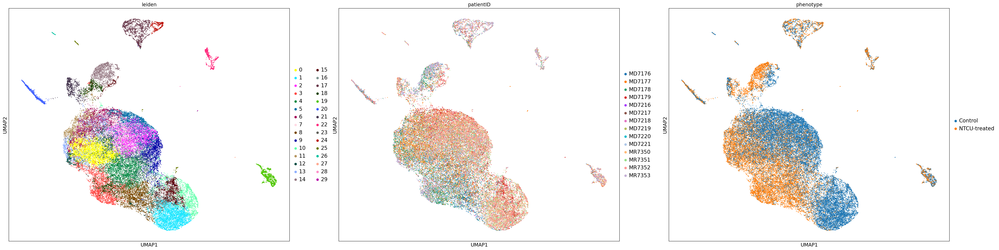

In [53]:
with mpl.rc_context({'figure.figsize': [15, 12],
                     'axes.facecolor': 'white'}):
    sc.pl.umap(adata, color=['leiden', 'patientID', 'phenotype'], size=12,
               color_map = 'RdPu', ncols = 3,
               legend_fontsize=15, save = "_NTCU_Trachea_clusters_tissue_mouse.pdf")

## CHECK MARKER GENES OF INTEREST 

In [ ]:
# visualise marker genes from GuoEtal2019, Nature Communications
guoEtal_celltype_genes = ['Krt5', 'Bcam', 'Aqp3', 'Wnt4', 'Trp63', 'Krt15', 
                          'Scgb1a1', 'Scgb3a1', 'Sftpd', 'Bpifb1', 'Sftpa1', 'Muc1', 'Scgb3a2', 'Muc5b',
                          'Muc4', 'Muc16',
                          'Il1b', 'Csf3r',
                          'Itk', 'Skap1', 'Lck', 'Cd3e', 'Cd3d', 
                          'Gstm1', 'Gstm2', 'Prdx1', 'Scgb3a2',
                          'Dnah12', 'Dnah5', 'Cfap44', 'Cfap61',
                          'Gngt2', 'Cst3', 'Fcer1g', 'Ace',
                          'Eng', 'Flt1', 'Egfl7', 'Pecam1',
                          'H2afz', 'Ptma', 'Stmn1', 'Hmgb2', 'Hmgn2', 'Ptn', 'Epcam', 'Ect2',
                          'Alox5ap', 'Ctss', 'Npc2', 'Mpeg1', 'Tyrobp',
                          'Adgrf5', 'Ramp2', 'Epas1', 'Egfl7',
                          'Il7r', 'Cxcr6', 'Cd3g', 'Cd3e', 'Icos', 'Il2ra',
                          'Mpeg1', 'Cd68',
                          'Cd74', 'Cd79a', 'Mef2c', 'H2-Aa',
                          'Clec3b', 'Mgp', 'Mxra8', 'Sparc', 'Inmt', 'Pcolce2',
                          'Cadm1', 'Siglech', 'Blnk', 'Irf8',
                          'Cftr'] 

sc.pl.dotplot(adata, guoEtal_celltype_genes, groupby='leiden', standard_scale='var', return_fig=True).style(grid=True, cmap='Blues', color_on='dot').swap_axes(swap_axes=False).savefig("NTCU_Trachea_leiden_GuoEtal2019_MarkerGenes.pdf")

In [55]:
# save the results at this point
adata.write(results_file)

## TAKE THE EPITHELIAL CELLS AND SUBCLUSTER FURTHER

In [56]:
# analysis can be restarted here
# adata = sc.read(results_file)

/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


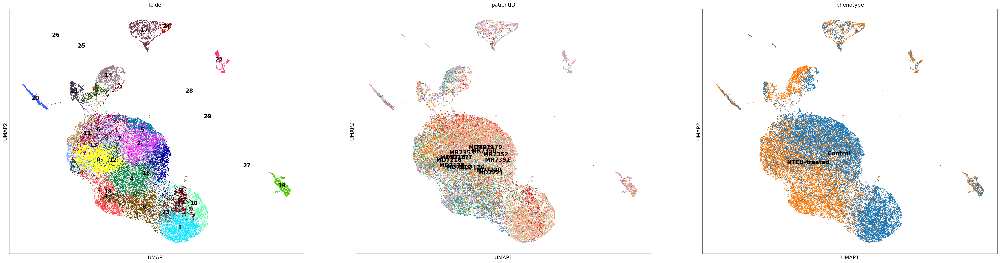

In [57]:
with mpl.rc_context({'figure.figsize': [15, 12],
                     'axes.facecolor': 'white'}):
    sc.pl.umap(adata, color=['leiden', 'patientID', 'phenotype'], size=12,
               color_map = 'RdPu', ncols = 3, legend_loc='on data',
               legend_fontsize=15, save = "_NTCU_Trachea_clusters_UMAP_on_data.pdf")

In [58]:
# assign overall cell types to each cluster for further subtype analysis
new_cluster_names = ['cluster0', 'cluster1', 'cluster2', 'cluster3', 'cluster4', 'cluster5', 'cluster6','cluster7', 
                     'cluster8', 'cluster9', 'cluster10', 'cluster11', 'cluster12', 'cluster13', 'cluster14','cluster15',
                     'cluster16', 'cluster17', 'cluster18', 'cluster19', 'cluster20', 'cluster21', 'cluster22',
                     'cluster23', 'cluster24', 'cluster25', 'cluster26', 'cluster27', 'cluster28', 'cluster29']
adata.rename_categories('leiden', new_cluster_names)

old_to_new = dict(
    cluster0='Epithelial cells',
    cluster1='Epithelial cells',
    cluster2='Epithelial cells',
    cluster3='Epithelial cells',
    cluster4='Epithelial cells',
    cluster5='Epithelial cells',
    cluster6='Epithelial cells',
    cluster7='Epithelial cells',
    cluster8='Epithelial cells',
    cluster9='Epithelial cells',
    cluster10='Epithelial cells',
    cluster11='Epithelial cells',
    cluster12='Epithelial cells',
    cluster13='Epithelial cells',
    cluster14='Epithelial cells',
    cluster15='Epithelial cells',
    cluster16='Epithelial cells',
    cluster17='Epithelial cells',
    cluster18='Epithelial cells',
    cluster19='T cells',
    cluster20='Epithelial cells',
    cluster21='Epithelial cells',
    cluster22='Macrophages',
    cluster23='Epithelial cells',
    cluster24='Epithelial cells',
    cluster25='Epithelial cells',
    cluster26='Epithelial cells',
    cluster27='Epithelial cells',
    cluster28='Epithelial cells',
    cluster29='Epithelial cells'
)
  
adata.obs['Cell_types'] = (
    adata.obs['leiden']
    .map(old_to_new)
    .astype('category')
)


/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


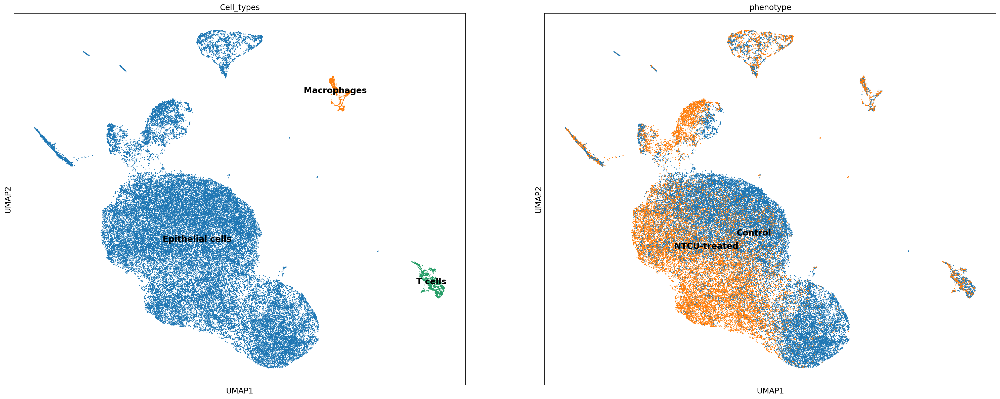

In [59]:
with mpl.rc_context({'figure.figsize': [15, 12],
                     'axes.facecolor': 'white'}):
    sc.pl.umap(adata, color=['Cell_types', 'phenotype'], size=12,
               color_map = 'RdPu', ncols = 4, legend_loc='on data',
               legend_fontsize=15, save = "_NTCU_Celltype_Trachea_UMAP_on_data.pdf")

In [ ]:
with mpl.rc_context({'figure.figsize': [15, 12],
                     'axes.facecolor': 'white'}):
    sc.pl.umap(adata, color=['patientID', 'age'], size=12,
               color_map = 'RdPu', ncols = 2,
               legend_fontsize=15, save = "_NTCU_MouseID_Age_Trachea_UMAP_on_data.pdf")

/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


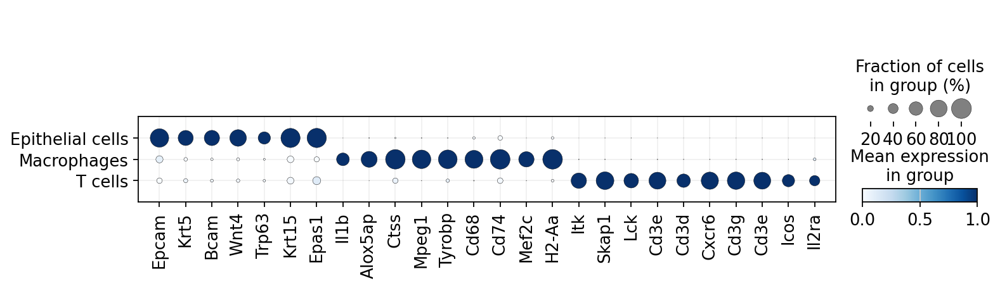

In [61]:
# visualise marker genes for the high-level celltypes
high_level_celltype_genes = ['Epcam', 'Krt5', 'Bcam', 'Wnt4', 'Trp63', 'Krt15', 'Epas1',
                          'Il1b', 'Alox5ap', 'Ctss', 'Mpeg1', 'Tyrobp', 'Cd68', 'Cd74', 'Mef2c', 'H2-Aa',
                          'Itk', 'Skap1', 'Lck', 'Cd3e', 'Cd3d', 'Cxcr6', 'Cd3g', 'Cd3e', 'Icos', 'Il2ra'] 

sc.pl.dotplot(adata, high_level_celltype_genes, groupby='Cell_types', standard_scale='var', return_fig=True).style(grid=True, cmap='Blues', color_on='dot').swap_axes(swap_axes=False).savefig("NTCU_Trachea_HighLevel_Celltypes.pdf")

In [62]:
# save the results at this point
adata.write('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/NTCU_GEX_Trachea_processed_Celltype.h5ad')

## SUBCLUSTERING OF EPITHELIAL CELLS

In [4]:
# subset whole dataset to the individual clusters present in the epithelial cell compartment
epithelial_adata = adata[(adata.obs["Cell_types"] == "Epithelial cells"),]
epithelial_cells = epithelial_adata.obs_names
epithelial_cells

adata = sc.read('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/NTCU_GEX_Trachea_raw.h5ad')
epithelial_adata = adata[epithelial_cells,]

In [6]:
sc.pp.normalize_total(epithelial_adata, target_sum=1e4)

/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


normalizing counts per cell
    finished (0:00:00)


In [7]:
sc.pp.log1p(epithelial_adata)

In [8]:
sc.pp.highly_variable_genes(epithelial_adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

extracting highly variable genes
    finished (0:00:02)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


In [ ]:
sc.pl.highly_variable_genes(epithelial_adata)

In [10]:
# set the raw attribute of anndata
epithelial_adata.raw = epithelial_adata

In [11]:
epithelial_adata = epithelial_adata[:, epithelial_adata.var.highly_variable]

In [12]:
# regress out effects of total counts per cell and the percentage of mitochondrial genes
sc.pp.regress_out(epithelial_adata, ['total_counts', 'pct_counts_mt', 'pct_counts_ribo'])

regressing out ['total_counts', 'pct_counts_mt', 'pct_counts_ribo']
    sparse input is densified and may lead to high memory use
    finished (0:07:11)


In [13]:
sc.pp.scale(epithelial_adata, max_value=10)
sc.tl.pca(epithelial_adata, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:01:11)


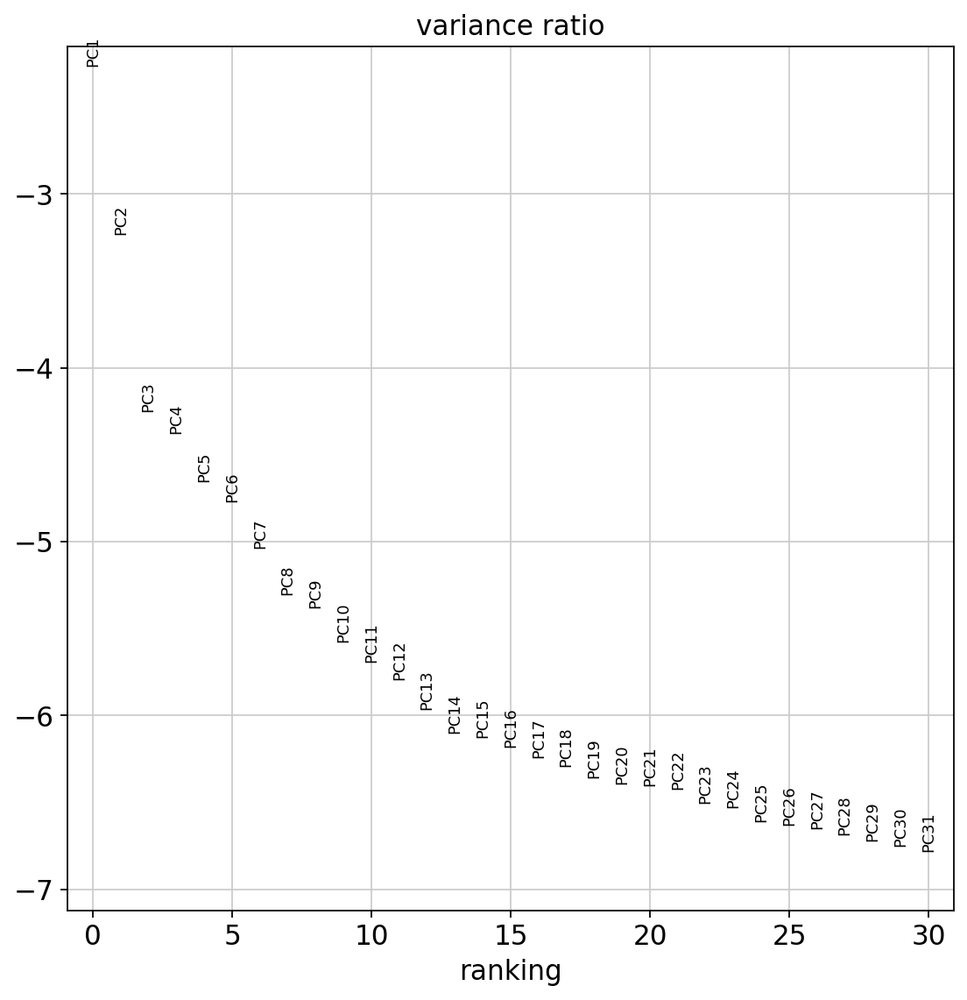

In [14]:
sc.pl.pca_variance_ratio(epithelial_adata, log=True)

In [15]:
# compute nearest neighbors, UMAP and clustering
sc.pp.neighbors(epithelial_adata, n_neighbors=10, n_pcs=10)
sc.tl.umap(epithelial_adata,
            n_components=2,
            min_dist=0.1,  # Scanpy default = 0.05
            spread=1.0,  # Scanpy default = 1.0

            # For some reason cannot access neighbors key slot, thus we
            # must keep uns['neighbors'] until we have run this.
            # neighbors_key='neighbors__{}'.format(plt__label),
            copy=False,
            random_state=0
        )
sc.tl.leiden(epithelial_adata, resolution= 0.8)

computing neighbors
    using 'X_pca' with n_pcs = 10
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:30)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:40)
running Leiden clustering
    finished: found 19 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:14)


/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


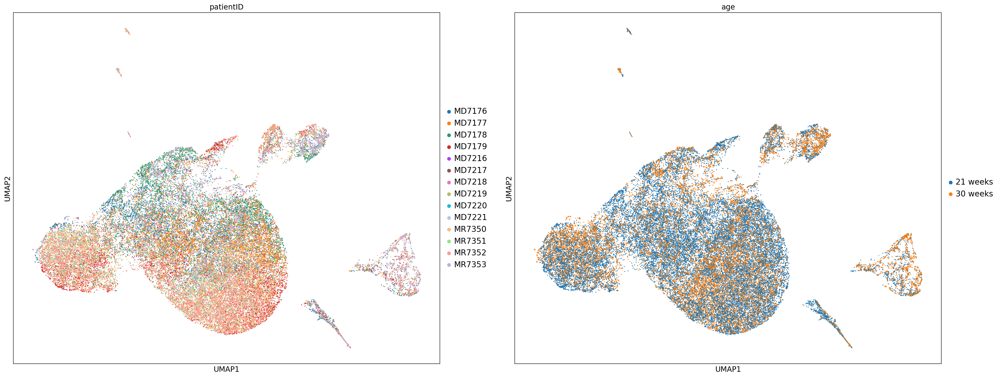

In [16]:
with mpl.rc_context({'figure.figsize': [15, 12],
                     'axes.facecolor': 'white'}):
    sc.pl.umap(epithelial_adata, color=['patientID', 'age'], size=12,
               color_map = 'RdPu', ncols = 2,
               legend_fontsize=15, save = "_NTCU_Trachea_MouseID_Age_epithelial_cells.pdf")

/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


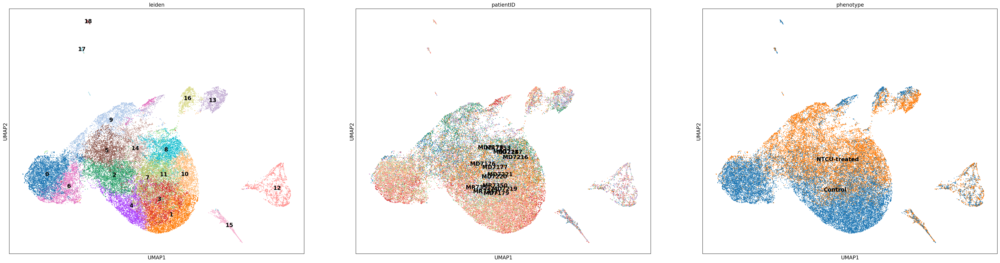

In [17]:
with mpl.rc_context({'figure.figsize': [15, 12],
                     'axes.facecolor': 'white'}):
    sc.pl.umap(epithelial_adata, color=['leiden', 'patientID', 'phenotype'], size=12,
               color_map = 'RdPu', ncols = 4, legend_loc='on data',
               legend_fontsize=15, save = "_NTCU_Trachea_clusters_epithelial_cells.pdf")

## Score MontoroEtal2018 Signatures in single cell data

In [18]:
montoro_sigs = pd.read_table("/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/MontoroEtal2018_Celltype_sigs.txt", sep = "\t")
montoro_sigs

,Cell_type,Gene
0,Basal,Aqp3
1,Basal,Icam1
2,Basal,Krt17
3,Basal,Krt5
4,Basal,Krt15
...,...,...
460,Ionocyte,Asgr1
461,Ionocyte,Parm1
462,Ionocyte,Atp6v1e1
463,Ionocyte,Iqgap1


In [19]:
# select only genes for the basal cells
basal_df = montoro_sigs.loc[montoro_sigs['Cell_type'] == "Basal",:]
basal_genes = basal_df['Gene']

# intersect with matrix
intersect_gene_list_basal=epithelial_adata.raw.var_names.isin(list(basal_genes))
basal_genes=epithelial_adata.raw.var_names[intersect_gene_list_basal]
len(basal_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(basal_genes), ctrl_size=len(basal_genes), gene_pool=None, n_bins=25, score_name='Montoro_Basal_Score', random_state=0, copy=False, use_raw=True)

computing score 'Montoro_Basal_Score'
    finished: added
    'Montoro_Basal_Score', score of gene set (adata.obs).
    196 total control genes are used. (0:00:03)


In [20]:
# select only genes for the club cells
club_df = montoro_sigs.loc[montoro_sigs['Cell_type'] == "Club",:]
club_genes = club_df['Gene']

# intersect with matrix
intersect_gene_list_club=epithelial_adata.raw.var_names.isin(list(club_genes))
club_genes=epithelial_adata.raw.var_names[intersect_gene_list_club]
len(club_genes)

# score genes in object
sc.tl.score_genes(epithelial_adata, list(club_genes), ctrl_size=len(club_genes), gene_pool=None, n_bins=25, score_name='Montoro_Club_Score', random_state=0, copy=False, use_raw=True)

computing score 'Montoro_Club_Score'
    finished: added
    'Montoro_Club_Score', score of gene set (adata.obs).
    124 total control genes are used. (0:00:03)


In [21]:
# select only genes for the ciliated cells
ciliated_df = montoro_sigs.loc[montoro_sigs['Cell_type'] == "Ciliated",:]
ciliated_genes = ciliated_df['Gene']

# intersect with matrix
intersect_gene_list_ciliated=epithelial_adata.raw.var_names.isin(list(ciliated_genes))
ciliated_genes=epithelial_adata.raw.var_names[intersect_gene_list_ciliated]
len(ciliated_genes)

# score genes in object
sc.tl.score_genes(epithelial_adata, list(ciliated_genes), ctrl_size=len(ciliated_genes), gene_pool=None, n_bins=25, score_name='Montoro_Ciliated_Score', random_state=0, copy=False, use_raw=True)

computing score 'Montoro_Ciliated_Score'
    finished: added
    'Montoro_Ciliated_Score', score of gene set (adata.obs).
    3902 total control genes are used. (0:00:04)


In [22]:
# select only genes for the tuft cells
tuft_df = montoro_sigs.loc[montoro_sigs['Cell_type'] == "Tuft",:]
tuft_genes = tuft_df['Gene']

# intersect with matrix
intersect_gene_list_tuft=epithelial_adata.raw.var_names.isin(list(tuft_genes))
tuft_genes=epithelial_adata.raw.var_names[intersect_gene_list_tuft]
len(tuft_genes)

# score genes in object
sc.tl.score_genes(epithelial_adata, list(tuft_genes), ctrl_size=len(tuft_genes), gene_pool=None, n_bins=25, score_name='Montoro_Tuft_Score', random_state=0, copy=False, use_raw=True)

computing score 'Montoro_Tuft_Score'
    finished: added
    'Montoro_Tuft_Score', score of gene set (adata.obs).
    1015 total control genes are used. (0:00:03)


In [23]:
# select only genes for the neuroendocrine cell type
neuro_df = montoro_sigs.loc[montoro_sigs['Cell_type'] == "Neuroendocrine",:]
neuro_genes = neuro_df['Gene']

# intersect with matrix
intersect_gene_list_neuro=epithelial_adata.raw.var_names.isin(list(neuro_genes))
neuro_genes=epithelial_adata.raw.var_names[intersect_gene_list_neuro]
len(neuro_genes)

# score genes in object
sc.tl.score_genes(epithelial_adata, list(neuro_genes), ctrl_size=len(neuro_genes), gene_pool=None, n_bins=25, score_name='Montoro_Neuroendocrine_Score', random_state=0, copy=False, use_raw=True)

computing score 'Montoro_Neuroendocrine_Score'
    finished: added
    'Montoro_Neuroendocrine_Score', score of gene set (adata.obs).
    371 total control genes are used. (0:00:03)


In [24]:
# select only genes for the ionocytes
ionocyte_df = montoro_sigs.loc[montoro_sigs['Cell_type'] == "Ionocyte",:]
ionocyte_genes = ionocyte_df['Gene']

# intersect with matrix
intersect_gene_list_ionocyte=epithelial_adata.raw.var_names.isin(list(ionocyte_genes))
ionocyte_genes=epithelial_adata.raw.var_names[intersect_gene_list_ionocyte]
len(ionocyte_genes)

# score genes in object
sc.tl.score_genes(epithelial_adata, list(ionocyte_genes), ctrl_size=len(ionocyte_genes), gene_pool=None, n_bins=25, score_name='Montoro_Ionocyte_Score', random_state=0, copy=False, use_raw=True)

computing score 'Montoro_Ionocyte_Score'
    finished: added
    'Montoro_Ionocyte_Score', score of gene set (adata.obs).
    162 total control genes are used. (0:00:03)


In [ ]:
with mpl.rc_context({'figure.figsize': [15, 12],
                     'axes.facecolor': 'white'}):
    sc.pl.umap(epithelial_adata, color=['Montoro_Ionocyte_Score', 'Montoro_Tuft_Score', 'Montoro_Club_Score', 'Montoro_Neuroendocrine_Score', 'Montoro_Basal_Score', 'Montoro_Ciliated_Score'], size=12,
               color_map = 'plasma', ncols = 3,
               legend_fontsize=15, save = "_NTCU_Trachea_Montoro_Scores.pdf")

## Score HurskainenEtal2022 Signatures in single cell data

In [26]:
hurskainen_sigs = pd.read_table("/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/HurskainenEtal2022_celltype_sigs.txt", sep = "\t")
hurskainen_sigs

,gene,p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster
0,Lyz2,0.000000e+00,1.393889,0.907,0.613,0.000000e+00,AT2
1,Sftpc,0.000000e+00,1.158080,1.000,0.968,0.000000e+00,AT2
2,Slc34a2,0.000000e+00,1.130718,0.998,0.430,0.000000e+00,AT2
3,S100g,0.000000e+00,1.074432,0.978,0.389,0.000000e+00,AT2
4,Sftpa1,0.000000e+00,1.071906,0.996,0.567,0.000000e+00,AT2
...,...,...,...,...,...,...,...
300,Wfdc2,2.490000e-194,1.061618,0.996,0.896,5.510000e-190,Club
301,Muc5b,6.190000e-173,1.043566,0.163,0.007,1.370000e-168,Club
302,Scgb3a1,5.930000e-171,3.787489,0.420,0.068,1.310000e-166,Club
303,Bpifa1,1.080000e-150,1.015851,0.131,0.005,2.390000e-146,Club


In [27]:
# select only genes for the basal cells
at2_df = hurskainen_sigs.loc[hurskainen_sigs['cluster'] == "AT2",:]
at2_genes = at2_df['gene']

# intersect with matrix
intersect_gene_list_at2=epithelial_adata.raw.var_names.isin(list(at2_genes))
at2_genes=epithelial_adata.raw.var_names[intersect_gene_list_at2]
len(at2_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(at2_genes), ctrl_size=len(at2_genes), gene_pool=None, n_bins=25, score_name='Hurskainen_AT2_Score', random_state=0, copy=False, use_raw=True)

computing score 'Hurskainen_AT2_Score'
    finished: added
    'Hurskainen_AT2_Score', score of gene set (adata.obs).
    42 total control genes are used. (0:00:03)


In [28]:
# select only genes for the basal cells
at1_df = hurskainen_sigs.loc[hurskainen_sigs['cluster'] == "AT1",:]
at1_genes = at1_df['gene']

# intersect with matrix
intersect_gene_list_at1=epithelial_adata.raw.var_names.isin(list(at1_genes))
at1_genes=epithelial_adata.raw.var_names[intersect_gene_list_at1]
len(at1_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(at1_genes), ctrl_size=len(at1_genes), gene_pool=None, n_bins=25, score_name='Hurskainen_AT1_Score', random_state=0, copy=False, use_raw=True)

computing score 'Hurskainen_AT1_Score'
    finished: added
    'Hurskainen_AT1_Score', score of gene set (adata.obs).
    2009 total control genes are used. (0:00:03)


In [29]:
# select only genes for the basal cells
ciliated_df = hurskainen_sigs.loc[hurskainen_sigs['cluster'] == "Ciliated",:]
ciliated_genes = ciliated_df['gene']

# intersect with matrix
intersect_gene_list_ciliated=epithelial_adata.raw.var_names.isin(list(ciliated_genes))
ciliated_genes=epithelial_adata.raw.var_names[intersect_gene_list_ciliated]
len(ciliated_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(ciliated_genes), ctrl_size=len(ciliated_genes), gene_pool=None, n_bins=25, score_name='Hurskainen_Ciliated_Score', random_state=0, copy=False, use_raw=True)

computing score 'Hurskainen_Ciliated_Score'
    finished: added
    'Hurskainen_Ciliated_Score', score of gene set (adata.obs).
    1800 total control genes are used. (0:00:03)


In [30]:
# select only genes for the basal cells
club_df = hurskainen_sigs.loc[hurskainen_sigs['cluster'] == "Club",:]
club_genes = club_df['gene']

# intersect with matrix
intersect_gene_list_club=epithelial_adata.raw.var_names.isin(list(club_genes))
club_genes=epithelial_adata.raw.var_names[intersect_gene_list_club]
len(club_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(club_genes), ctrl_size=len(club_genes), gene_pool=None, n_bins=25, score_name='Hurskainen_Club_Score', random_state=0, copy=False, use_raw=True)

computing score 'Hurskainen_Club_Score'
    finished: added
    'Hurskainen_Club_Score', score of gene set (adata.obs).
    175 total control genes are used. (0:00:03)


In [ ]:
with mpl.rc_context({'figure.figsize': [15, 12],
                     'axes.facecolor': 'white'}):
    sc.pl.umap(epithelial_adata, color=['Hurskainen_AT2_Score', 'Hurskainen_AT1_Score','Hurskainen_Ciliated_Score', 'Hurskainen_Club_Score'], size=12,
               color_map = 'plasma', ncols = 3,
               legend_fontsize=15, save = "_NTCU_Trachea_Hurskainen_Scores.pdf")

## Score ChenEtal2022 Signatures in single cell data

In [32]:
chen_sigs = pd.read_table("/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/ChenEtal2022_celltype_sigs.txt", sep = "\t")
chen_sigs

,gene,celltype
0,Sftpc,AT2
1,Sftpa1,AT2
2,Slc34a2,AT2
3,Sftpb,AT2
4,Lyz2,AT2
...,...,...
324,Igfbp7,PATS
325,Marcksl1,PATS
326,Cfl1,PATS
327,Myl12b,PATS


In [33]:
# select only genes for the basal cells
at2_df = chen_sigs.loc[chen_sigs['celltype'] == "AT2",:]
at2_genes = at2_df['gene']

# intersect with matrix
intersect_gene_list_at2=epithelial_adata.raw.var_names.isin(list(at2_genes))
at2_genes=epithelial_adata.raw.var_names[intersect_gene_list_at2]
len(at2_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(at2_genes), ctrl_size=len(at2_genes), gene_pool=None, n_bins=25, score_name='Chen_AT2_Score', random_state=0, copy=False, use_raw=True)

computing score 'Chen_AT2_Score'
    finished: added
    'Chen_AT2_Score', score of gene set (adata.obs).
    351 total control genes are used. (0:00:03)


In [34]:
# select only genes for the basal cells
club_df = chen_sigs.loc[chen_sigs['celltype'] == "Club",:]
club_genes = club_df['gene']

# intersect with matrix
intersect_gene_list_club=epithelial_adata.raw.var_names.isin(list(club_genes))
club_genes=epithelial_adata.raw.var_names[intersect_gene_list_club]
len(club_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(club_genes), ctrl_size=len(club_genes), gene_pool=None, n_bins=25, score_name='Chen_Club_Score', random_state=0, copy=False, use_raw=True)

computing score 'Chen_Club_Score'
    finished: added
    'Chen_Club_Score', score of gene set (adata.obs).
    197 total control genes are used. (0:00:02)


In [35]:
# select only genes for the basal cells
at1_df = chen_sigs.loc[chen_sigs['celltype'] == "AT1",:]
at1_genes = at1_df['gene']

# intersect with matrix
intersect_gene_list_at1=epithelial_adata.raw.var_names.isin(list(at1_genes))
at1_genes=epithelial_adata.raw.var_names[intersect_gene_list_at1]
len(at1_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(at1_genes), ctrl_size=len(at1_genes), gene_pool=None, n_bins=25, score_name='Chen_AT1_Score', random_state=0, copy=False, use_raw=True)

computing score 'Chen_AT1_Score'
    finished: added
    'Chen_AT1_Score', score of gene set (adata.obs).
    289 total control genes are used. (0:00:02)


In [36]:
# select only genes for the basal cells
basal_df = chen_sigs.loc[chen_sigs['celltype'] == "Basal Cell",:]
basal_genes = basal_df['gene']

# intersect with matrix
intersect_gene_list_basal=epithelial_adata.raw.var_names.isin(list(basal_genes))
basal_genes=epithelial_adata.raw.var_names[intersect_gene_list_basal]
len(basal_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(basal_genes), ctrl_size=len(basal_genes), gene_pool=None, n_bins=25, score_name='Chen_Basal_Score', random_state=0, copy=False, use_raw=True)

computing score 'Chen_Basal_Score'
    finished: added
    'Chen_Basal_Score', score of gene set (adata.obs).
    60 total control genes are used. (0:00:02)


In [37]:
# select only genes for the basal cells
goblet_df = chen_sigs.loc[chen_sigs['celltype'] == "Goblet",:]
goblet_genes = goblet_df['gene']

# intersect with matrix
intersect_gene_list_goblet=epithelial_adata.raw.var_names.isin(list(goblet_genes))
goblet_genes=epithelial_adata.raw.var_names[intersect_gene_list_goblet]
len(goblet_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(goblet_genes), ctrl_size=len(goblet_genes), gene_pool=None, n_bins=25, score_name='Chen_Goblet_Score', random_state=0, copy=False, use_raw=True)

computing score 'Chen_Goblet_Score'
    finished: added
    'Chen_Goblet_Score', score of gene set (adata.obs).
    203 total control genes are used. (0:00:03)


In [38]:
# select only genes for the basal cells
krt8_df = chen_sigs.loc[chen_sigs['celltype'] == "Krt8_ADI",:]
krt8_genes = krt8_df['gene']

# intersect with matrix
intersect_gene_list_krt8=epithelial_adata.raw.var_names.isin(list(krt8_genes))
krt8_genes=epithelial_adata.raw.var_names[intersect_gene_list_krt8]
len(krt8_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(krt8_genes), ctrl_size=len(krt8_genes), gene_pool=None, n_bins=25, score_name='Chen_Krt8_Score', random_state=0, copy=False, use_raw=True)

computing score 'Chen_Krt8_Score'
    finished: added
    'Chen_Krt8_Score', score of gene set (adata.obs).
    179 total control genes are used. (0:00:03)


In [39]:
# select only genes for the basal cells
proliferation_df = chen_sigs.loc[chen_sigs['celltype'] == "Proliferation",:]
proliferation_genes = proliferation_df['gene']

# intersect with matrix
intersect_gene_list_proliferation=epithelial_adata.raw.var_names.isin(list(proliferation_genes))
proliferation_genes=epithelial_adata.raw.var_names[intersect_gene_list_proliferation]
len(proliferation_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(proliferation_genes), ctrl_size=len(proliferation_genes), gene_pool=None, n_bins=25, score_name='Chen_Proliferation_Score', random_state=0, copy=False, use_raw=True)

computing score 'Chen_Proliferation_Score'
    finished: added
    'Chen_Proliferation_Score', score of gene set (adata.obs).
    234 total control genes are used. (0:00:02)


In [40]:
# select only genes for the basal cells
club_progenitor_df = chen_sigs.loc[chen_sigs['celltype'] == "Club_progenitor",:]
club_progenitor_genes = club_progenitor_df['gene']

# intersect with matrix
intersect_gene_list_club_progenitor=epithelial_adata.raw.var_names.isin(list(club_progenitor_genes))
club_progenitor_genes=epithelial_adata.raw.var_names[intersect_gene_list_club_progenitor]
len(club_progenitor_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(club_progenitor_genes), ctrl_size=len(club_progenitor_genes), gene_pool=None, n_bins=25, score_name='Chen_Club_Progenitor_Score', random_state=0, copy=False, use_raw=True)

computing score 'Chen_Club_Progenitor_Score'
    finished: added
    'Chen_Club_Progenitor_Score', score of gene set (adata.obs).
    12 total control genes are used. (0:00:02)


In [41]:
# select only genes for the basal cells
at1_at2_df = chen_sigs.loc[chen_sigs['celltype'] == "Mixed_AT1_AT2",:]
at1_at2_genes = at1_at2_df['gene']

# intersect with matrix
intersect_gene_list_at1_at2=epithelial_adata.raw.var_names.isin(list(at1_at2_genes))
at1_at2_genes=epithelial_adata.raw.var_names[intersect_gene_list_at1_at2]
len(at1_at2_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(at1_at2_genes), ctrl_size=len(at1_at2_genes), gene_pool=None, n_bins=25, score_name='Chen_AT1_AT2_Score', random_state=0, copy=False, use_raw=True)

computing score 'Chen_AT1_AT2_Score'
    finished: added
    'Chen_AT1_AT2_Score', score of gene set (adata.obs).
    80 total control genes are used. (0:00:02)


In [42]:
# select only genes for the basal cells
act_club_df = chen_sigs.loc[chen_sigs['celltype'] == "Activated Club",:]
act_club_genes = act_club_df['gene']

# intersect with matrix
intersect_gene_list_act_club=epithelial_adata.raw.var_names.isin(list(act_club_genes))
act_club_genes=epithelial_adata.raw.var_names[intersect_gene_list_act_club]
len(act_club_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(act_club_genes), ctrl_size=len(act_club_genes), gene_pool=None, n_bins=25, score_name='Chen_Activated_Club_Score', random_state=0, copy=False, use_raw=True)

computing score 'Chen_Activated_Club_Score'
    finished: added
    'Chen_Activated_Club_Score', score of gene set (adata.obs).
    112 total control genes are used. (0:00:03)


In [43]:
tumour_df = chen_sigs.loc[chen_sigs['celltype'] == "Tumour",:]
tumour_genes = tumour_df['gene']

# intersect with matrix
intersect_gene_list_tumour=epithelial_adata.raw.var_names.isin(list(tumour_genes))
tumour_genes=epithelial_adata.raw.var_names[intersect_gene_list_tumour]
len(tumour_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(tumour_genes), ctrl_size=len(tumour_genes), gene_pool=None, n_bins=25, score_name='Chen_Tumour_Score', random_state=0, copy=False, use_raw=True)

computing score 'Chen_Tumour_Score'
    finished: added
    'Chen_Tumour_Score', score of gene set (adata.obs).
    356 total control genes are used. (0:00:03)


In [44]:
datp_df = chen_sigs.loc[chen_sigs['celltype'] == "DATP",:]
datp_genes = datp_df['gene']

# intersect with matrix
intersect_gene_list_datp=epithelial_adata.raw.var_names.isin(list(datp_genes))
datp_genes=epithelial_adata.raw.var_names[intersect_gene_list_datp]
len(datp_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(datp_genes), ctrl_size=len(datp_genes), gene_pool=None, n_bins=25, score_name='Chen_DATP_Score', random_state=0, copy=False, use_raw=True)

computing score 'Chen_DATP_Score'
    finished: added
    'Chen_DATP_Score', score of gene set (adata.obs).
    136 total control genes are used. (0:00:03)


In [45]:
pats_df = chen_sigs.loc[chen_sigs['celltype'] == "PATS",:]
pats_genes = pats_df['gene']

# intersect with matrix
intersect_gene_list_pats=epithelial_adata.raw.var_names.isin(list(pats_genes))
pats_genes=epithelial_adata.raw.var_names[intersect_gene_list_pats]
len(pats_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(pats_genes), ctrl_size=len(pats_genes), gene_pool=None, n_bins=25, score_name='Chen_PATS_Score', random_state=0, copy=False, use_raw=True)

computing score 'Chen_PATS_Score'
    finished: added
    'Chen_PATS_Score', score of gene set (adata.obs).
    486 total control genes are used. (0:00:03)


In [ ]:
with mpl.rc_context({'figure.figsize': [15, 12],
                     'axes.facecolor': 'white'}):
    sc.pl.umap(epithelial_adata, color=['Chen_AT2_Score', 'Chen_AT1_Score', 'Chen_Activated_Club_Score', 'Chen_AT1_AT2_Score', 'Chen_Club_Progenitor_Score',
                                        'Chen_Proliferation_Score', 'Chen_Krt8_Score', 'Chen_Goblet_Score', 'Chen_Club_Score', 'Chen_Goblet_Score', 'Chen_Basal_Score',
                                        'Chen_Tumour_Score', 'Chen_PATS_Score', 'Chen_DATP_Score'], size=12,
               color_map = 'plasma', ncols = 3,
               legend_fontsize=15, save = "_NTCU_Trachea_Chen_Scores.pdf")

## Score GoldfarbmurenEtal2022 Signatures in single cell data

In [47]:
goldfarbmuren_celltype_sigs = pd.read_table("/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/GoldfarbmurenEtal2022_translated_celltype_sigs.txt", sep = "\t")
goldfarbmuren_celltype_sigs

,gene,avg_logFC,p_val,p_adj_FDR,pct.1,pct.2,cell_type,MGI.symbol
0,A1BG,0.257198,8.313000e-122,1.887900e-121,0.256,0.067,SMG basal,A1bg
1,A1BG,0.496552,2.273980e-22,6.573550e-22,0.482,0.075,PNEC,A1bg
2,A4GALT,0.466511,0.000000e+00,0.000000e+00,0.958,0.813,KRT8 high,A4galt
3,AAAS,0.272770,3.367700e-259,5.394300e-259,0.515,0.257,Proliferating basal,Aaas
4,AACS,0.258927,2.948190e-06,3.236450e-06,0.663,0.383,PNEC,Aacs
...,...,...,...,...,...,...,...,...
8395,ZSCAN5A,0.282050,3.254900e-262,4.326400e-262,0.351,0.093,Ciliated,Zscan5b
8396,ZSWIM7,0.704138,4.156140e-29,1.478250e-28,0.843,0.483,PNEC,Zswim7
8397,ZWILCH,0.468653,0.000000e+00,0.000000e+00,0.537,0.131,Proliferating basal,Zwilch
8398,ZWINT,1.319324,0.000000e+00,0.000000e+00,0.860,0.128,Proliferating basal,Zwint


In [48]:
smg_basal_df = goldfarbmuren_celltype_sigs.loc[goldfarbmuren_celltype_sigs['cell_type'] == "SMG basal",:]
smg_basal_genes = smg_basal_df['MGI.symbol']

# intersect with matrix
intersect_gene_list_smg_basal=epithelial_adata.raw.var_names.isin(list(smg_basal_genes))
smg_basal_genes=epithelial_adata.raw.var_names[intersect_gene_list_smg_basal]
len(smg_basal_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(smg_basal_genes), ctrl_size=len(smg_basal_genes), gene_pool=None, n_bins=25, score_name='Goldfarbmuren_SMG_Basal_Score', random_state=0, copy=False, use_raw=True)

computing score 'Goldfarbmuren_SMG_Basal_Score'
    finished: added
    'Goldfarbmuren_SMG_Basal_Score', score of gene set (adata.obs).
    4493 total control genes are used. (0:00:03)


In [49]:
ciliated_df = goldfarbmuren_celltype_sigs.loc[goldfarbmuren_celltype_sigs['cell_type'] == "Ciliated",:]
ciliated_genes = ciliated_df['MGI.symbol']

# intersect with matrix
intersect_gene_list_ciliated=epithelial_adata.raw.var_names.isin(list(ciliated_genes))
ciliated_genes=epithelial_adata.raw.var_names[intersect_gene_list_ciliated]
len(ciliated_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(ciliated_genes), ctrl_size=len(ciliated_genes), gene_pool=None, n_bins=25, score_name='Goldfarbmuren_Ciliated_Score', random_state=0, copy=False, use_raw=True)

computing score 'Goldfarbmuren_Ciliated_Score'
    finished: added
    'Goldfarbmuren_Ciliated_Score', score of gene set (adata.obs).
    23592 total control genes are used. (0:00:44)


In [50]:
diff_basal_df = goldfarbmuren_celltype_sigs.loc[goldfarbmuren_celltype_sigs['cell_type'] == "Differentiating basal",:]
diff_basal_genes = diff_basal_df['MGI.symbol']

# intersect with matrix
intersect_gene_list_diff_basal=epithelial_adata.raw.var_names.isin(list(diff_basal_genes))
diff_basal_genes=epithelial_adata.raw.var_names[intersect_gene_list_diff_basal]
len(diff_basal_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(diff_basal_genes), ctrl_size=len(diff_basal_genes), gene_pool=None, n_bins=25, score_name='Goldfarbmuren_Diff_Basal_Score', random_state=0, copy=False, use_raw=True)

computing score 'Goldfarbmuren_Diff_Basal_Score'
    finished: added
    'Goldfarbmuren_Diff_Basal_Score', score of gene set (adata.obs).
    7444 total control genes are used. (0:00:04)


In [51]:
iono_tuft_df = goldfarbmuren_celltype_sigs.loc[goldfarbmuren_celltype_sigs['cell_type'] == "Ionocyte/tuft",:]
iono_tuft_genes = iono_tuft_df['MGI.symbol']

# intersect with matrix
intersect_gene_list_iono_tuft=epithelial_adata.raw.var_names.isin(list(iono_tuft_genes))
iono_tuft_genes=epithelial_adata.raw.var_names[intersect_gene_list_iono_tuft]
len(iono_tuft_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(iono_tuft_genes), ctrl_size=len(iono_tuft_genes), gene_pool=None, n_bins=25, score_name='Goldfarbmuren_Ionocytes_Tuft_Score', random_state=0, copy=False, use_raw=True)

computing score 'Goldfarbmuren_Ionocytes_Tuft_Score'
    finished: added
    'Goldfarbmuren_Ionocytes_Tuft_Score', score of gene set (adata.obs).
    20342 total control genes are used. (0:00:05)


In [52]:
krt8_df = goldfarbmuren_celltype_sigs.loc[goldfarbmuren_celltype_sigs['cell_type'] == "KRT8 high",:]
krt8_genes = krt8_df['MGI.symbol']

# intersect with matrix
intersect_gene_list_krt8=epithelial_adata.raw.var_names.isin(list(krt8_genes))
krt8_genes=epithelial_adata.raw.var_names[intersect_gene_list_krt8]
len(krt8_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(krt8_genes), ctrl_size=len(krt8_genes), gene_pool=None, n_bins=25, score_name='Goldfarbmuren_Krt8_High_Score', random_state=0, copy=False, use_raw=True)

computing score 'Goldfarbmuren_Krt8_High_Score'
    finished: added
    'Goldfarbmuren_Krt8_High_Score', score of gene set (adata.obs).
    5618 total control genes are used. (0:00:04)


In [53]:
mucus_secretory_df = goldfarbmuren_celltype_sigs.loc[goldfarbmuren_celltype_sigs['cell_type'] == "Mucus secretory",:]
mucus_secretory_genes = mucus_secretory_df['MGI.symbol']

# intersect with matrix
intersect_gene_list_mucus_secretory=epithelial_adata.raw.var_names.isin(list(mucus_secretory_genes))
mucus_secretory_genes=epithelial_adata.raw.var_names[intersect_gene_list_mucus_secretory]
len(mucus_secretory_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(mucus_secretory_genes), ctrl_size=len(mucus_secretory_genes), gene_pool=None, n_bins=25, score_name='Goldfarbmuren_Mucus_Secretory_Score', random_state=0, copy=False, use_raw=True)

computing score 'Goldfarbmuren_Mucus_Secretory_Score'
    finished: added
    'Goldfarbmuren_Mucus_Secretory_Score', score of gene set (adata.obs).
    16193 total control genes are used. (0:00:05)


In [54]:
pnec_df = goldfarbmuren_celltype_sigs.loc[goldfarbmuren_celltype_sigs['cell_type'] == "PNEC",:]
pnec_genes = mucus_secretory_df['MGI.symbol']

# intersect with matrix
intersect_gene_list_mucus_secretory=epithelial_adata.raw.var_names.isin(list(pnec_genes))
pnec_genes=epithelial_adata.raw.var_names[intersect_gene_list_mucus_secretory]
len(pnec_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(pnec_genes), ctrl_size=len(pnec_genes), gene_pool=None, n_bins=25, score_name='Goldfarbmuren_PNEC_Score', random_state=0, copy=False, use_raw=True)

computing score 'Goldfarbmuren_PNEC_Score'
    finished: added
    'Goldfarbmuren_PNEC_Score', score of gene set (adata.obs).
    16193 total control genes are used. (0:00:05)


In [55]:
prolif_basal_df = goldfarbmuren_celltype_sigs.loc[goldfarbmuren_celltype_sigs['cell_type'] == "Proliferating basal",:]
prolif_basal_genes = prolif_basal_df['MGI.symbol']

# intersect with matrix
intersect_gene_list_prolif_basal=epithelial_adata.raw.var_names.isin(list(prolif_basal_genes))
prolif_basal_genes=epithelial_adata.raw.var_names[intersect_gene_list_prolif_basal]
len(prolif_basal_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(prolif_basal_genes), ctrl_size=len(prolif_basal_genes), gene_pool=None, n_bins=25, score_name='Goldfarbmuren_Proliferating_Basal_Score', random_state=0, copy=False, use_raw=True)

computing score 'Goldfarbmuren_Proliferating_Basal_Score'
    finished: added
    'Goldfarbmuren_Proliferating_Basal_Score', score of gene set (adata.obs).
    23573 total control genes are used. (0:00:21)


In [56]:
proteasome_basal_df = goldfarbmuren_celltype_sigs.loc[goldfarbmuren_celltype_sigs['cell_type'] == "Proteasomal basal",:]
proteasome_basal_genes = proteasome_basal_df['MGI.symbol']

# intersect with matrix
intersect_gene_list_proteasome_basal=epithelial_adata.raw.var_names.isin(list(proteasome_basal_genes))
proteasome_basal_genes=epithelial_adata.raw.var_names[intersect_gene_list_proteasome_basal]
len(proteasome_basal_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(proteasome_basal_genes), ctrl_size=len(proteasome_basal_genes), gene_pool=None, n_bins=25, score_name='Goldfarbmuren_Proteasomal_Basal_Score', random_state=0, copy=False, use_raw=True)

computing score 'Goldfarbmuren_Proteasomal_Basal_Score'
    finished: added
    'Goldfarbmuren_Proteasomal_Basal_Score', score of gene set (adata.obs).
    20040 total control genes are used. (0:00:05)


In [57]:
SMG_secretory_df = goldfarbmuren_celltype_sigs.loc[goldfarbmuren_celltype_sigs['cell_type'] == "SMG secretory",:]
SMG_secretory_genes = SMG_secretory_df['MGI.symbol']

# intersect with matrix
intersect_gene_list_smg_secretory=epithelial_adata.raw.var_names.isin(list(SMG_secretory_genes))
SMG_secretory_genes=epithelial_adata.raw.var_names[intersect_gene_list_smg_secretory]
len(SMG_secretory_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(SMG_secretory_genes), ctrl_size=len(SMG_secretory_genes), gene_pool=None, n_bins=25, score_name='Goldfarbmuren_SMG_Secretory_Score', random_state=0, copy=False, use_raw=True)

computing score 'Goldfarbmuren_SMG_Secretory_Score'
    finished: added
    'Goldfarbmuren_SMG_Secretory_Score', score of gene set (adata.obs).
    7336 total control genes are used. (0:00:04)


In [ ]:
with mpl.rc_context({'figure.figsize': [15, 12],
                     'axes.facecolor': 'white'}):
    sc.pl.umap(epithelial_adata, color=['Goldfarbmuren_SMG_Basal_Score', 'Goldfarbmuren_Ciliated_Score', 'Goldfarbmuren_Diff_Basal_Score',
                                        'Goldfarbmuren_Ionocytes_Tuft_Score', 'Goldfarbmuren_Krt8_High_Score', 'Goldfarbmuren_Mucus_Secretory_Score', 'Goldfarbmuren_PNEC_Score',
                                        'Goldfarbmuren_Proliferating_Basal_Score', 'Goldfarbmuren_Proteasomal_Basal_Score', 'Goldfarbmuren_SMG_Secretory_Score'], size=12,
               color_map = 'plasma', ncols = 3,
               legend_fontsize=15, save = "_NTCU_Trachea_Goldfarbmuren_Scores.pdf")

## Score GoldfarbmurenEtal2022 Smoking signatures in single cell data

In [59]:
goldfarbmuren_smoking_up_sigs = pd.read_table("/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/GoldfarbmurenEtal2022_translated_celltype_smoking_up_sigs.txt", sep = "\t")
goldfarbmuren_smoking_up_sigs

,gene,avg_logFC,p_val,p_adj_FDR,pct.1,pct.2,comparison,Status,MGI.symbol
0,ABHD2,0.434368,1.414320e-18,5.526720e-18,0.915,0.940,Mature ciliated,Unique,Abhd2
1,ABL2,0.322822,1.442050e-08,2.548140e-08,0.560,0.434,Proteasomal basal,Unique,Abl2
2,ACAT2,0.448273,7.904930e-11,8.344100e-11,0.521,0.503,KRT8 high,Core,Acat3
3,ACAT2,0.448273,7.904930e-11,8.344100e-11,0.521,0.503,KRT8 high,Core,Acat2
4,ACAT2,0.382284,2.542610e-08,9.560230e-08,0.510,0.385,SMG basal,Core,Acat3
...,...,...,...,...,...,...,...,...,...
1612,ZFP36,0.307015,4.210600e-22,2.228110e-21,0.935,0.853,Mature ciliated,Unique,Zfp36
1613,ZNF593,0.250724,3.523120e-17,6.589040e-17,0.793,0.778,Proliferating basal,Unique,Zfp593
1614,ZNHIT1,0.257021,2.207480e-11,7.112990e-11,0.923,0.894,Proteasomal basal,Unique,Znhit1
1615,ZYX,0.284983,2.292090e-19,4.759000e-19,0.715,0.659,Proliferating basal,Semiunique,Zyx


In [60]:
goldfarbmuren_smoking_down_sigs = pd.read_table("/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/GoldfarbmurenEtal2022_translated_celltype_smoking_down_sigs.txt", sep = "\t")
goldfarbmuren_smoking_down_sigs

,gene,avg_logFC,p_val,p_adj_FDR,pct.1,pct.2,cell_type,Status,MGI.symbol
0,ABCA1,-0.287567,1.291410e-15,3.034820e-15,0.401,0.210,SMG basal,Semiunique,Abca1
1,ABCA1,-0.258979,8.105370e-72,1.090540e-71,0.434,0.267,Differentiating basal,Semiunique,Abca1
2,ABCA13,-0.297108,3.341280e-20,4.648730e-20,0.912,0.822,Mucus secretory,Semiunique,Abca13
3,ABCA13,-0.269540,9.784748e-03,1.384184e-02,0.316,0.218,SMG secretory,Semiunique,Abca13
4,ADH1C,-0.678207,2.663100e-210,2.189600e-209,0.855,0.716,Differentiating basal,Core,Adh1
...,...,...,...,...,...,...,...,...,...
442,VMO1,-0.352853,1.705900e-10,1.890320e-10,0.606,0.526,Mature ciliated,Semiunique,Vmo1
443,VMO1,-0.314969,6.077090e-31,6.765060e-31,0.811,0.762,KRT8 high,Semiunique,Vmo1
444,VMO1,-0.348934,2.276090e-13,2.540750e-13,0.971,0.955,Mucus secretory,Semiunique,Vmo1
445,VMO1,-0.254047,3.068380e-05,3.988900e-05,0.674,0.587,Proteasomal basal,Semiunique,Vmo1


In [61]:
core_response_down = goldfarbmuren_smoking_down_sigs.loc[goldfarbmuren_smoking_down_sigs['Status'] == "Core",:]
core_response_down_genes = core_response_down['MGI.symbol'].unique()

# intersect with matrix
intersect_gene_list_core_response_down=epithelial_adata.raw.var_names.isin(list(core_response_down_genes))
core_response_down_genes=epithelial_adata.raw.var_names[intersect_gene_list_core_response_down]
len(core_response_down_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(core_response_down_genes), ctrl_size=len(core_response_down_genes), gene_pool=None, n_bins=25, score_name='Goldfarbmuren_Core_Response_Down_Score', random_state=0, copy=False, use_raw=True)

computing score 'Goldfarbmuren_Core_Response_Down_Score'
    finished: added
    'Goldfarbmuren_Core_Response_Down_Score', score of gene set (adata.obs).
    350 total control genes are used. (0:00:03)


In [62]:
core_response_up = goldfarbmuren_smoking_up_sigs.loc[goldfarbmuren_smoking_up_sigs['Status'] == "Core",:]
core_response_up_genes = core_response_up['MGI.symbol'].unique()

# intersect with matrix
intersect_gene_list_core_response_up=epithelial_adata.raw.var_names.isin(list(core_response_up_genes))
core_response_up_genes=epithelial_adata.raw.var_names[intersect_gene_list_core_response_up]
len(core_response_up_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(core_response_up_genes), ctrl_size=len(core_response_up_genes), gene_pool=None, n_bins=25, score_name='Goldfarbmuren_Core_Response_Up_Score', random_state=0, copy=False, use_raw=True)

computing score 'Goldfarbmuren_Core_Response_Up_Score'
    finished: added
    'Goldfarbmuren_Core_Response_Up_Score', score of gene set (adata.obs).
    1615 total control genes are used. (0:00:03)


In [ ]:
with mpl.rc_context({'figure.figsize': [15, 12],
                     'axes.facecolor': 'white'}):
    sc.pl.umap(epithelial_adata, color=['Goldfarbmuren_Core_Response_Up_Score', 'Goldfarbmuren_Core_Response_Down_Score'], size=12,
               color_map = 'plasma', ncols = 3,
               legend_fontsize=15, save = "_NTCU_Trachea_Goldfarbmuren_Smoking_Core_Up_Scores.pdf")

## Score PlasschaertEtal2018 Signatures in single cell data

In [64]:
plasschaert_celltype_sigs = pd.read_table("/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/PlaesschaertEtal2018_celltype_sigs.txt", sep = "\t")
plasschaert_celltype_sigs

,gene,celltype
0,Krt5,Basal & Cycling basal pooled
1,Igfbp7,Basal & Cycling basal pooled
2,Ltbp4,Basal & Cycling basal pooled
3,Crlf1,Basal & Cycling basal pooled
4,Sparc,Basal & Cycling basal pooled
...,...,...
2240,Ak6,Ionocytes
2241,Acss1,Ionocytes
2242,Pde1c,Ionocytes
2243,Blcap,Ionocytes


In [66]:
basal_cycling_pooled_df = plasschaert_celltype_sigs.loc[plasschaert_celltype_sigs['celltype'] == "Basal & Cycling basal pooled",:]
basal_cycling_pooled_genes = basal_cycling_pooled_df['gene']

# intersect with matrix
intersect_gene_list_basal_cycling_pooled=epithelial_adata.raw.var_names.isin(list(basal_cycling_pooled_genes))
basal_cycling_pooled_genes=epithelial_adata.raw.var_names[intersect_gene_list_basal_cycling_pooled]
len(basal_cycling_pooled_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(basal_cycling_pooled_genes), ctrl_size=len(basal_cycling_pooled_genes), gene_pool=None, n_bins=25, score_name='Plasschaert_Basal_Cycling_pooled_Score', random_state=0, copy=False, use_raw=True)

computing score 'Plasschaert_Basal_Cycling_pooled_Score'
    finished: added
    'Plasschaert_Basal_Cycling_pooled_Score', score of gene set (adata.obs).
    790 total control genes are used. (0:00:03)


In [ ]:
basal_cycling_pooled_df = plasschaert_celltype_sigs.loc[plasschaert_celltype_sigs['celltype'] == "Basal & Cycling basal pooled",:]
basal_cycling_pooled_genes = basal_cycling_pooled_df['gene']

# intersect with matrix
intersect_gene_list_basal_cycling_pooled=epithelial_adata.raw.var_names.isin(list(basal_cycling_pooled_genes))
basal_cycling_pooled_genes=epithelial_adata.raw.var_names[intersect_gene_list_basal_cycling_pooled]
len(basal_cycling_pooled_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(basal_cycling_pooled_genes), ctrl_size=len(basal_cycling_pooled_genes), gene_pool=None, n_bins=25, score_name='Plasschaert_Basal_Cycling_pooled_Score', random_state=0, copy=False, use_raw=True)

In [67]:
basal_df = plasschaert_celltype_sigs.loc[plasschaert_celltype_sigs['celltype'] == "Basal",:]
basal_genes = basal_df['gene']

# intersect with matrix
intersect_gene_list_basal=epithelial_adata.raw.var_names.isin(list(basal_genes))
basal_genes=epithelial_adata.raw.var_names[intersect_gene_list_basal]
len(basal_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(basal_genes), ctrl_size=len(basal_genes), gene_pool=None, n_bins=25, score_name='Plasschaert_Basal_Score', random_state=0, copy=False, use_raw=True)

computing score 'Plasschaert_Basal_Score'
    finished: added
    'Plasschaert_Basal_Score', score of gene set (adata.obs).
    497 total control genes are used. (0:00:03)


In [68]:
basal_cycling_df = plasschaert_celltype_sigs.loc[plasschaert_celltype_sigs['celltype'] == "Cycling Basal",:]
basal_cycling_genes = basal_cycling_df['gene']

# intersect with matrix
intersect_gene_list_basal_cycling=epithelial_adata.raw.var_names.isin(list(basal_cycling_genes))
basal_cycling_genes=epithelial_adata.raw.var_names[intersect_gene_list_basal_cycling]
len(basal_cycling_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(basal_cycling_genes), ctrl_size=len(basal_cycling_genes), gene_pool=None, n_bins=25, score_name='Plasschaert_Basal_Cycling_Score', random_state=0, copy=False, use_raw=True)

computing score 'Plasschaert_Basal_Cycling_Score'
    finished: added
    'Plasschaert_Basal_Cycling_Score', score of gene set (adata.obs).
    3558 total control genes are used. (0:00:03)


In [69]:
krt4_df = plasschaert_celltype_sigs.loc[plasschaert_celltype_sigs['celltype'] == "Krt4/13+",:]
krt4_genes = krt4_df['gene']

# intersect with matrix
intersect_gene_list_krt4=epithelial_adata.raw.var_names.isin(list(krt4_genes))
krt4_genes=epithelial_adata.raw.var_names[intersect_gene_list_krt4]
len(krt4_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(krt4_genes), ctrl_size=len(krt4_genes), gene_pool=None, n_bins=25, score_name='Plasschaert_Krt4_Krt13_Score', random_state=0, copy=False, use_raw=True)

computing score 'Plasschaert_Krt4_Krt13_Score'
    finished: added
    'Plasschaert_Krt4_Krt13_Score', score of gene set (adata.obs).
    1872 total control genes are used. (0:00:03)


In [70]:
secretory_df = plasschaert_celltype_sigs.loc[plasschaert_celltype_sigs['celltype'] == "Secretory",:]
secretory_genes = secretory_df['gene']

# intersect with matrix
intersect_gene_list_secretory=epithelial_adata.raw.var_names.isin(list(secretory_genes))
secretory_genes=epithelial_adata.raw.var_names[intersect_gene_list_secretory]
len(secretory_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(secretory_genes), ctrl_size=len(secretory_genes), gene_pool=None, n_bins=25, score_name='Plasschaert_Secretory_Score', random_state=0, copy=False, use_raw=True)

computing score 'Plasschaert_Secretory_Score'
    finished: added
    'Plasschaert_Secretory_Score', score of gene set (adata.obs).
    959 total control genes are used. (0:00:03)


In [71]:
ciliated_df = plasschaert_celltype_sigs.loc[plasschaert_celltype_sigs['celltype'] == "Ciliated",:]
ciliated_genes = ciliated_df['gene']

# intersect with matrix
intersect_gene_list_basal_cycling_pooled=epithelial_adata.raw.var_names.isin(list(ciliated_genes))
ciliated_genes=epithelial_adata.raw.var_names[intersect_gene_list_basal_cycling_pooled]
len(ciliated_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(ciliated_genes), ctrl_size=len(ciliated_genes), gene_pool=None, n_bins=25, score_name='Plasschaert_Ciliated_Score', random_state=0, copy=False, use_raw=True)

computing score 'Plasschaert_Ciliated_Score'
    finished: added
    'Plasschaert_Ciliated_Score', score of gene set (adata.obs).
    11292 total control genes are used. (0:00:05)


In [72]:
brush_df = plasschaert_celltype_sigs.loc[plasschaert_celltype_sigs['celltype'] == "Brush",:]
brush_genes = brush_df['gene']

# intersect with matrix
intersect_gene_list_brush=epithelial_adata.raw.var_names.isin(list(brush_genes))
brush_genes=epithelial_adata.raw.var_names[intersect_gene_list_brush]
len(brush_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(brush_genes), ctrl_size=len(brush_genes), gene_pool=None, n_bins=25, score_name='Plasschaert_Brush_Score', random_state=0, copy=False, use_raw=True)

computing score 'Plasschaert_Brush_Score'
    finished: added
    'Plasschaert_Brush_Score', score of gene set (adata.obs).
    6066 total control genes are used. (0:00:04)


In [73]:
pnec_df = plasschaert_celltype_sigs.loc[plasschaert_celltype_sigs['celltype'] == "PNEC",:]
pnec_genes = pnec_df['gene']

# intersect with matrix
intersect_gene_list_pnec=epithelial_adata.raw.var_names.isin(list(pnec_genes))
pnec_genes=epithelial_adata.raw.var_names[intersect_gene_list_pnec]
len(pnec_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(pnec_genes), ctrl_size=len(pnec_genes), gene_pool=None, n_bins=25, score_name='Plasschaert_PNEC_Score', random_state=0, copy=False, use_raw=True)

computing score 'Plasschaert_PNEC_Score'
    finished: added
    'Plasschaert_PNEC_Score', score of gene set (adata.obs).
    8780 total control genes are used. (0:00:05)


In [74]:
ionocyte_df = plasschaert_celltype_sigs.loc[plasschaert_celltype_sigs['celltype'] == "Ionocytes",:]
ionocyte_genes = ionocyte_df['gene']

# intersect with matrix
intersect_gene_list_ionocyte=epithelial_adata.raw.var_names.isin(list(ionocyte_genes))
ionocyte_genes=epithelial_adata.raw.var_names[intersect_gene_list_ionocyte]
len(ionocyte_genes)

# score in object
sc.tl.score_genes(epithelial_adata, list(ionocyte_genes), ctrl_size=len(ionocyte_genes), gene_pool=None, n_bins=25, score_name='Plasschaert_Ionocyte_Score', random_state=0, copy=False, use_raw=True)

computing score 'Plasschaert_Ionocyte_Score'
    finished: added
    'Plasschaert_Ionocyte_Score', score of gene set (adata.obs).
    1692 total control genes are used. (0:00:04)


In [ ]:
with mpl.rc_context({'figure.figsize': [15, 12],
                     'axes.facecolor': 'white'}):
    sc.pl.umap(epithelial_adata, color=['Plasschaert_Basal_Cycling_pooled_Score', 'Plasschaert_Basal_Score', 'Plasschaert_Basal_Cycling_Score','Plasschaert_Krt4_Krt13_Score', 'Plasschaert_Secretory_Score', 'Plasschaert_Ciliated_Score',
                                        'Plasschaert_Brush_Score', 'Plasschaert_PNEC_Score', 'Plasschaert_Ionocyte_Score'], size=12,
               color_map = 'plasma', ncols = 3,
               legend_fontsize=15, save = "_NTCU_Trachea_Plasschaert_Celltype_Scores.pdf")

In [ ]:
# generate the metadata for plotting of the trachea cell types
metadata = pd.DataFrame(epithelial_adata.obs, index=epithelial_adata.obs_names)
metadata.to_csv('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/NTCU_Trachea_Celltype_Scores_Metadata.csv')

## The visualisation of and maximum scoring per cluster was implemented in a custom R script. This evaluated the overarching epithelial cell types which were utilised downstream.

In [70]:
# assign overall cell types to each cluster for further subtype analysis
new_cluster_names = ['cluster0', 'cluster1', 'cluster2', 'cluster3', 'cluster4', 'cluster5', 'cluster6','cluster7', 
                     'cluster8', 'cluster9', 'cluster10', 'cluster11', 'cluster12', 'cluster13', 'cluster14','cluster15',
                     'cluster16', 'cluster17', 'cluster18']
epithelial_adata.rename_categories('leiden', new_cluster_names)

old_to_new = dict(
    cluster0='Club/Secretory cells',
    cluster1='Basal cells',
    cluster2='Basal cells',
    cluster3='Basal cells',
    cluster4='Basal cells',
    cluster5='Basal cells',
    cluster6='Club/Secretory cells',
    cluster7='Basal cells',
    cluster8='Basal cells',
    cluster9='Club/Secretory cells',
    cluster10='Basal cells', 
    cluster11='Basal cells',
    cluster12='Ciliated cells', 
    cluster13='Club/Secretory cells', 
    cluster14='Basal cells',
    cluster15='Proliferative basal cells',
    cluster16='Basal cells',
    cluster17='Tuft',
    cluster18='Ionocytes'
)
  
epithelial_adata.obs['epithelial_celltypes'] = (
    epithelial_adata.obs['leiden']
    .map(old_to_new)
    .astype('category')
)


In [ ]:
with mpl.rc_context({'figure.figsize': [15, 12],
                     'axes.facecolor': 'white'}):
    sc.pl.umap(epithelial_adata, color=['leiden','epithelial_celltypes', 'phenotype'], size=12,
               color_map = 'RdPu', ncols = 3, legend_loc='on data',
               legend_fontsize=15, save = "_NTCU_Trachea_clusters_epithelial_cells.pdf")

/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


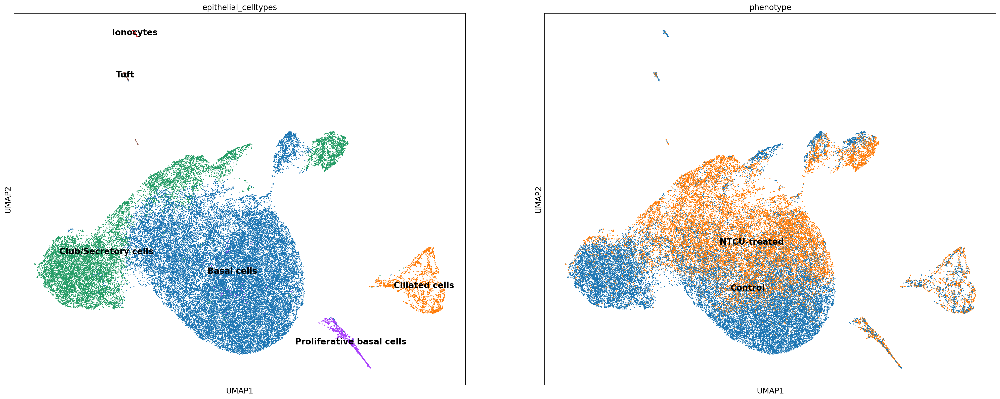

In [73]:
with mpl.rc_context({'figure.figsize': [15, 12],
                     'axes.facecolor': 'white'}):
    sc.pl.umap(epithelial_adata, color=['epithelial_celltypes', 'phenotype'], size=12,
               color_map = 'RdPu', ncols = 2, legend_loc='on data',
               legend_fontsize=15, save = "_NTCU_Trachea_Epithelial_Celltype.pdf")

In [3]:
# again, can start from here as well
epithelial_adata = sc.read('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/NTCU_Trachea_Epithelial_Celltype.h5ad')

/software/team152/mp34/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


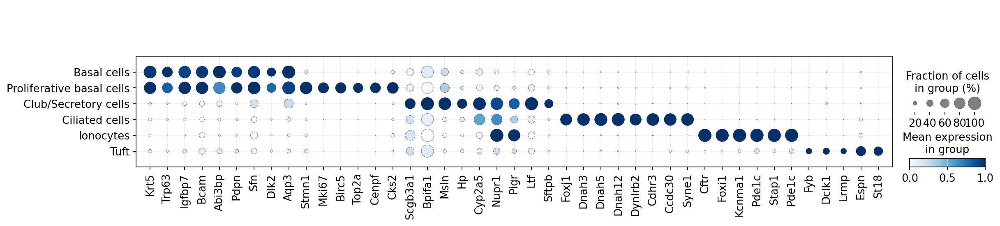

In [8]:
# visualise cell type genes in right order
celltype_genes = ['Krt5', "Trp63", 'Igfbp7', 'Bcam', 'Abi3bp', 'Pdpn', 'Sfn', 'Dlk2', 'Aqp3', # Basal cells
                  'Stmn1', 'Mki67', "Birc5", 'Top2a', 'Cenpf', 'Cks2',  # Proliferative cells
                  'Scgb3a1', 'Bpifa1', 'Msln', 'Hp', 'Cyp2a5', 'Nupr1', 'Pigr', 'Ltf', 'Sftpb', # Secretory
                  'Foxj1', "Dnah3", "Dnah5", 'Dnah12', 'Dynlrb2', 'Cdhr3', 'Ccdc30', 'Syne1', # Ciliated
                  "Cftr", 'Foxi1', 'Kcnma1', 'Pde1c', 'Stap1', 'Pde1c', # Ionocyte
                  'Fyb', "Dclk1", "Lrmp", 'Espn', 'St18' ]# Tuft]

rcParams['figure.figsize'] = (10, 10)
sc.pl.dotplot(epithelial_adata, celltype_genes, groupby='epithelial_celltypes', 
              categories_order = ['Basal cells', 'Proliferative basal cells', 'Club/Secretory cells', 'Ciliated cells', 'Ionocytes', 'Tuft'], standard_scale='var', return_fig=True).style(grid=True, cmap='Blues', color_on='dot').swap_axes(swap_axes=False).savefig("NTCU_Trachea_Epithelial_Celltype.pdf")

In [82]:
# store object with annotated cell types
epithelial_adata.write('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/NTCU_Trachea_Epithelial_Celltype.h5ad')

## SCORE GENESETS FROM BEANE ET AL 2019

In [83]:
beane_sigs = pd.read_table("/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/BeaneEtal2019_GeneModules.txt", sep = "\t")
beane_sigs

,Module,gene
0,Module_5,A4galt
1,Module_2,Aaas
2,Module_8,Aatk
3,Module_6,Abca1
4,Module_2,Abca7
...,...,...
3339,Module_6,Zscan5b
3340,Module_6,Zswim4
3341,Module_5,Zwilch
3342,Module_5,Zwint


In [84]:
# select only genes for the ionocytes
module1_df = beane_sigs.loc[beane_sigs['Module'] == "Module_1",:]
module1_genes = module1_df['gene']

# intersect with matrix
intersect_gene_list_module1=epithelial_adata.raw.var_names.isin(list(module1_genes))
module1_genes=epithelial_adata.raw.var_names[intersect_gene_list_module1]
len(module1_genes)

# score genes in object
sc.tl.score_genes(epithelial_adata, list(module1_genes), ctrl_size=len(module1_genes), gene_pool=None, n_bins=25, score_name='Beane_Module1_Score', random_state=0, copy=False, use_raw=True)

computing score 'Beane_Module1_Score'
    finished: added
    'Beane_Module1_Score', score of gene set (adata.obs).
    11419 total control genes are used. (0:00:03)


In [85]:
# select only genes for the ionocytes
module2_df = beane_sigs.loc[beane_sigs['Module'] == "Module_2",:]
module2_genes = module2_df['gene']

# intersect with matrix
intersect_gene_list_module2=epithelial_adata.raw.var_names.isin(list(module2_genes))
module2_genes=epithelial_adata.raw.var_names[intersect_gene_list_module2]
len(module2_genes)

# score genes in object
sc.tl.score_genes(epithelial_adata, list(module2_genes), ctrl_size=len(module2_genes), gene_pool=None, n_bins=25, score_name='Beane_Module2_Score', random_state=0, copy=False, use_raw=True)

computing score 'Beane_Module2_Score'
    finished: added
    'Beane_Module2_Score', score of gene set (adata.obs).
    13182 total control genes are used. (0:00:03)


In [86]:
# select only genes for the ionocytes
module3_df = beane_sigs.loc[beane_sigs['Module'] == "Module_3",:]
module3_genes = module3_df['gene']

# intersect with matrix
intersect_gene_list_module3=epithelial_adata.raw.var_names.isin(list(module3_genes))
module3_genes=epithelial_adata.raw.var_names[intersect_gene_list_module3]
len(module3_genes)

# score genes in object
sc.tl.score_genes(epithelial_adata, list(module3_genes), ctrl_size=len(module3_genes), gene_pool=None, n_bins=25, score_name='Beane_Module3_Score', random_state=0, copy=False, use_raw=True)

computing score 'Beane_Module3_Score'
    finished: added
    'Beane_Module3_Score', score of gene set (adata.obs).
    159 total control genes are used. (0:00:01)


In [87]:
# select only genes for the ionocytes
module4_df = beane_sigs.loc[beane_sigs['Module'] == "Module_4",:]
module4_genes = module4_df['gene']

# intersect with matrix
intersect_gene_list_module4=epithelial_adata.raw.var_names.isin(list(module4_genes))
module4_genes=epithelial_adata.raw.var_names[intersect_gene_list_module4]
len(module4_genes)

# score genes in object
sc.tl.score_genes(epithelial_adata, list(module4_genes), ctrl_size=len(module4_genes), gene_pool=None, n_bins=25, score_name='Beane_Module4_Score', random_state=0, copy=False, use_raw=True)

computing score 'Beane_Module4_Score'
    finished: added
    'Beane_Module4_Score', score of gene set (adata.obs).
    465 total control genes are used. (0:00:02)


In [88]:
# select only genes for the ionocytes
module5_df = beane_sigs.loc[beane_sigs['Module'] == "Module_5",:]
module5_genes = module5_df['gene']

# intersect with matrix
intersect_gene_list_module5=epithelial_adata.raw.var_names.isin(list(module5_genes))
module5_genes=epithelial_adata.raw.var_names[intersect_gene_list_module5]
len(module5_genes)

# score genes in object
sc.tl.score_genes(epithelial_adata, list(module5_genes), ctrl_size=len(module5_genes), gene_pool=None, n_bins=25, score_name='Beane_Module5_Score', random_state=0, copy=False, use_raw=True)

computing score 'Beane_Module5_Score'
    finished: added
    'Beane_Module5_Score', score of gene set (adata.obs).
    2966 total control genes are used. (0:00:02)


In [89]:
# select only genes for the ionocytes
module6_df = beane_sigs.loc[beane_sigs['Module'] == "Module_6",:]
module6_genes = module6_df['gene']

# intersect with matrix
intersect_gene_list_module6=epithelial_adata.raw.var_names.isin(list(module6_genes))
module6_genes=epithelial_adata.raw.var_names[intersect_gene_list_module6]
len(module6_genes)

# score genes in object
sc.tl.score_genes(epithelial_adata, list(module6_genes), ctrl_size=len(module6_genes), gene_pool=None, n_bins=25, score_name='Beane_Module6_Score', random_state=0, copy=False, use_raw=True)

computing score 'Beane_Module6_Score'
    finished: added
    'Beane_Module6_Score', score of gene set (adata.obs).
    23440 total control genes are used. (0:00:03)


In [90]:
# select only genes for the ionocytes
module7_df = beane_sigs.loc[beane_sigs['Module'] == "Module_7",:]
module7_genes = module7_df['gene']

# intersect with matrix
intersect_gene_list_module7=epithelial_adata.raw.var_names.isin(list(module7_genes))
module7_genes=epithelial_adata.raw.var_names[intersect_gene_list_module7]
len(module7_genes)

# score genes in object
sc.tl.score_genes(epithelial_adata, list(module7_genes), ctrl_size=len(module7_genes), gene_pool=None, n_bins=25, score_name='Beane_Module7_Score', random_state=0, copy=False, use_raw=True)

computing score 'Beane_Module7_Score'
    finished: added
    'Beane_Module7_Score', score of gene set (adata.obs).
    1355 total control genes are used. (0:00:02)


In [91]:
# select only genes for the ionocytes
module8_df = beane_sigs.loc[beane_sigs['Module'] == "Module_8",:]
module8_genes = module8_df['gene']

# intersect with matrix
intersect_gene_list_module8=epithelial_adata.raw.var_names.isin(list(module8_genes))
module8_genes=epithelial_adata.raw.var_names[intersect_gene_list_module8]
len(module8_genes)

# score genes in object
sc.tl.score_genes(epithelial_adata, list(module8_genes), ctrl_size=len(module8_genes), gene_pool=None, n_bins=25, score_name='Beane_Module8_Score', random_state=0, copy=False, use_raw=True)

computing score 'Beane_Module8_Score'
    finished: added
    'Beane_Module8_Score', score of gene set (adata.obs).
    13482 total control genes are used. (0:00:03)


In [92]:
# select only genes for the ionocytes
module9_df = beane_sigs.loc[beane_sigs['Module'] == "Module_9",:]
module9_genes = module9_df['gene']

# intersect with matrix
intersect_gene_list_module9=epithelial_adata.raw.var_names.isin(list(module9_genes))
module9_genes=epithelial_adata.raw.var_names[intersect_gene_list_module9]
len(module9_genes)

# score genes in object
sc.tl.score_genes(epithelial_adata, list(module9_genes), ctrl_size=len(module9_genes), gene_pool=None, n_bins=25, score_name='Beane_Module9_Score', random_state=0, copy=False, use_raw=True)

computing score 'Beane_Module9_Score'
    finished: added
    'Beane_Module9_Score', score of gene set (adata.obs).
    2518 total control genes are used. (0:00:02)


In [ ]:
with mpl.rc_context({'figure.figsize': [15, 12],
                     'axes.facecolor': 'white'}):
    sc.pl.umap(epithelial_adata, color=['Beane_Module1_Score', 'Beane_Module2_Score', 'Beane_Module3_Score', 'Beane_Module4_Score', 
                                        'Beane_Module5_Score', 'Beane_Module6_Score', 'Beane_Module7_Score', 'Beane_Module8_Score', 
                                        'Beane_Module9_Score'], size=12,
               color_map = 'plasma', ncols = 3,
               legend_fontsize=15, save = "_NTCU_Trachea_Beane_Gene_Modules.pdf")

In [94]:
# generate the metadata for plotting of the trachea cell types
metadata = pd.DataFrame(epithelial_adata.obs, index=epithelial_adata.obs_names)
metadata.to_csv('/lustre/scratch126/casm/team154pc/mp34/lung/NTCU/scRNA/NTCU_Trachea_Epithelial_Celltype_Metadata.csv')